# Construct developmental trajectory using Palantir

In [1]:
# Import modules
import palantir
import scanpy as sc
import numpy as np
import pandas as pd
import os

# Plotting 
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

import scipy.stats
import anndata
import matplotlib as mpl
from matplotlib.axes._axes import _log as matplotlib_axes_logger
from scipy import sparse
matplotlib_axes_logger.setLevel('ERROR')



# Inline plotting
%matplotlib inline

sns.set_style('ticks')
matplotlib.rcParams['figure.figsize'] = [4, 4]
matplotlib.rcParams['figure.dpi'] = 100
matplotlib.rcParams['image.cmap'] = 'Spectral_r'
warnings.filterwarnings(action="ignore", module="matplotlib", message="findfont")


pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 800)


sc.settings.verbosity = 1  # verbosity: errors (0), warnings (1), info (2), hints (3)
# Set up the plot config for viewing the annotation clearly.
sc.settings.set_figure_params(dpi=120, dpi_save=1000)
#sc.logging.print_versions()


# Reset random seed
np.random.seed(5)

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.


# Helper functions

In [2]:
# ad = adata object
# ann_key = column name containing cell type annotation
# start_cell = user's defined cellID as the start of the trajectory
# marker_genes = list of key marker genes for plotting
# result_out_fp = path to output the results
# num_waypoints = number of waypoints (palantir parameter)
# n_top_genes = number of top genes for clustering
# n_components = number of PCs
# runHarmony = logical, should harmony be run for integration
# harmonyVar = if runHarmony == T, what are the variables for batch correction

## output: palantir_results, adata_object


def build_palantir_traj_v2(ad,ann_key,start_cell,marker_genes=['CD34', 'MPO', 'GATA1', 'IRF8','HBB','PF4','KLF1','FLI1'],
                           result_out_fp=None,num_waypoints=1200, n_top_genes=1500,n_comps=50,n_components=5,terminal_states=None,
                           runHarmony=False,harmonyVar=None,
                           use_early_cell_as_start=False,determine_termState=False,terminal_celltypes=[]):
    
    ### Data processing - assuming input anndata contains raw count (not normalized / scaled)
    print('Data processing...')
    # Normalisation
    sc.pp.normalize_per_cell(ad)
    # log1p transformation, palantir function uses a pseudocount of 0.1 instead of 1.
    palantir.preprocess.log_transform(ad)
    
    # Select highly variable genes
    sc.pp.highly_variable_genes(ad, n_top_genes=n_top_genes)
    
    
    ### PCA
    print('Computing PCA...')
    sc.pp.pca(ad,n_comps=n_comps)
    sc.pl.pca_scatter(ad, color='CD34')
    
    if runHarmony:
        ### Harmony
        print('Running Harmony')
        sc.external.pp.harmony_integrate(ad,harmonyVar)
        
    
    ### Compute Diffusion maps
    print('Computing Diffusion maps...') 
    # Run diffusion maps
    if runHarmony:
        dm_res = palantir.utils.run_diffusion_maps(ad, n_components=n_components,pca_key="X_pca_harmony")
        sc.pp.neighbors(ad,use_rep='X_pca_harmony')     
    else:
        dm_res = palantir.utils.run_diffusion_maps(ad, n_components=n_components)
        sc.pp.neighbors(ad)  
    
    # The low dimensional embeddeing of the data is estimated based on the eigen gap using the following function
    ms_data = palantir.utils.determine_multiscale_space(ad)
    
    ### Visualization
    # Recommend using FDG, but UMAP is a good alternative for visualization
    
    sc.tl.umap(ad)
    # Use scanpy functions to visualize umaps or FDL
    sc.pl.embedding(ad, basis='umap',color=ann_key,palette='tab10')
    
    # Diffusion map visualisation
    palantir.plot.plot_diffusion_components(ad)
    plt.show()
    
    ### MAGIC imputation
    print('MAGIC imputation...')
    #imputed_X = palantir.utils.run_magic_imputation(ad)
    #sc.pl.embedding(ad, basis='umap', layer='MAGIC_imputed_data',
    #               color=marker_genes)
    
    
    ### Plot start cells
    #palantir.plot.highlight_cells_on_umap(ad, {'start_cell':start_cell})
    ad.obs['isStartCell'] = [x == start_cell for x in ad.obs.index.tolist()]
    palantir.plot.highlight_cells_on_umap(ad,'isStartCell')
    
    plt.show()
    
    if determine_termState and (len(terminal_celltypes) > 0) and not terminal_states:
        terminal_states = []
        for ct in terminal_celltypes:
            termCell = palantir.utils.early_cell(ad, ct, ann_key)
            terminal_states.append(termCell)
   
    #ad.obs['isStartCell'] = [x == start_cell for x in ad.obs.index.tolist()]
    #palantir.plot.highlight_cells_on_umap(ad,'isStartCell')
    
    ### Running Palantir
    print('Computing trajectory with Palantir...')
    pr_res = palantir.core.run_palantir(ad, start_cell, num_waypoints=num_waypoints,
                                        terminal_states=terminal_states,
                                       use_early_cell_as_start=use_early_cell_as_start)
    
    ### Branch selection
    masks = palantir.presults.select_branch_cells(ad, eps=0)
    palantir.plot.plot_branch_selection(ad)
    plt.show()
    
    ### Extract Palantir results
    mask_output = pd.DataFrame.from_records(ad.obsm['branch_masks'],index=ad.obsm['branch_masks'].index)
    results = pr_res.branch_probs
    
    mdat = pd.merge(ad.obs,mask_output,left_index=True, right_index=True)
    mdat = pd.merge(mdat,results,left_index=True, right_index=True)
    
    ## Save output
    if result_out_fp:
        mdat.to_csv(result_out_fp)
            
    palantir.plot.plot_palantir_results(ad, s=3)
    plt.show()
    
    return(mdat,ad)

In [3]:
def plot_pseudotime(results,plotDir):
    
    import seaborn as sns
    sns.set(style='ticks')
    
    results['branch'] = results.iloc[:,0:(results.shape[1]-5)].idxmax(axis=1)
    results['entropy_2'] = np.where(results['branch'] == results.columns[1],1 - results['entropy'],results['entropy'])
    print((results['entropy_2'] == results['entropy']).value_counts())
    ### Visualising Palantir results
    ## plot pseudotime against entropy, coloured by branch assignment
    sns.relplot(data=results, x='pseudotime', y='entropy_2', hue='branch', aspect=1.1, size=0.1)
    plt.show()
    
    #results[['branch']] = np.where(results.Ery > results.MK, 'red','blue')
    #results.plot.scatter(x='pseudotime',y='entropy',c='branch',s=1)
    # Plot by cell type
    sns.relplot(data=results, x='pseudotime', y='entropy_2', hue='finalAnn_broad', aspect=1.1, size=0.1)
    plt.show()
    
    #results.plot.scatter(x='pseudotime',y='entropy',c='ct_color',s=1)


In [4]:
def standard_clustering(adata,ann_key=[],n_neighbors=10, n_pcs=40):
    import scanpy as sc
    print('Data processing...')
    # Normalisation
    #sc.pp.filter_genes(adata, min_cells=100)|
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    adata.raw = adata
    sc.pp.highly_variable_genes(adata)#, min_mean=0.0125, max_mean=3, min_disp=0.5)
    #sc.pl.highly_variable_genes(adata)
    sc.pp.scale(adata)#, max_value=10)
    sc.tl.pca(adata, svd_solver='arpack')
    sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs)
    sc.tl.umap(adata)
    if len(ann_key) > 0:
        sc.pl.umap(adata,color=ann_key)
    else:
        sc.pl.umap(adata)
        
    return adata

# Import data

In [5]:
seed = 42
np.random.seed(seed)

adata = sc.read_h5ad('/lustre/scratch125/casm/team274sb/mt22/Aneuploidy/Results/2_annotation/liver/jun24/liver_clean_processed_annotated_noUnknowns_0724.h5ad')
print(adata.obs['Phase'].value_counts())
adata.obs.finalAnn_broad = adata.obs.annot_jun24

print(adata.obs.donorID[adata.obs.Genotype == 'T21'].value_counts())
# Remove cycling cells
#adata_noCyc = adata[(adata.obs['Phase'] == 'G1')]
# Subset to include only cell types of interest (if needed)
#adata_noCyc = adata[(adata.obs['finalAnn_broad'].isin([])) & (adata.obs['Phase'] == 'G1')]

# print(adata_noCyc.obs['annot_sept23'].value_counts())

# # Plot UMAP
# sc.pl.embedding(adata_noCyc, basis='umap',color=['finalAnn_broad'],palette='tab10')


G1     309517
G2M    177258
S      166619
Name: Phase, dtype: int64
Hsb34    57828
Hsb36    53948
Hsb37    52897
Hsb38    52796
Hsb39    46492
Hsb33    37658
15877    17526
15724    16116
15680        0
Hsb32        0
Hsb35        0
Hsb31        0
Hsb22        0
Hsb21        0
16049        0
15905        0
15806        0
15756        0
15733        0
Hsb40        0
Name: donorID, dtype: int64


In [6]:
#print(adata.obs.donorID[adata.obs.Genotype == 'diploid'].value_counts())

/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


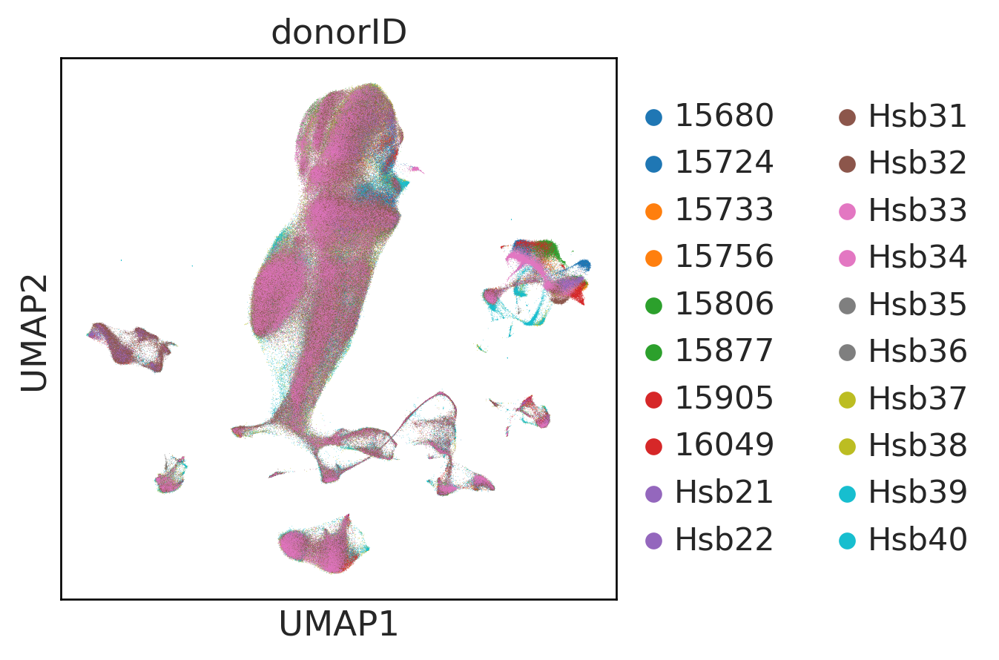

In [7]:
sc.pl.embedding(adata, basis='umap',color=['donorID'],palette='tab10')

In [8]:
adata.obs['annot_jun24'][adata.obs['cellID_toKeep'] == True].value_counts()

KeyError: 'cellID_toKeep'

In [9]:
celltypes_toKeep = ['HSC_MPP','MEMP_MEP','EE','ME','LE',
                    'Mast.cell','earlyMK','MK']
# celltypes_toKeep = ['HSC_MPP','MEMP_MEP','EE','ME','LE',
#                     'Mast.cell','earlyMK','MK',
#                    'LMPP_ELP','pro.B.cell','pre.B.cell','B.cell',
#                     'CMP_GMP','proMono','MOP','Monocyte']#,'Macrophage']

# Build Trajectory with Palantir

## Run Palantir on 2n

In [11]:
adata.obs['finalAnn'][adata.obs.donorID == 'Hsb35'].value_counts()

ME               19951
LE               16678
EE                4887
Endo              4492
pre.B.cell        3074
Hepatocyte        1767
pro.B.cell        1712
B.cell            1160
MK                1110
HSC_MPP            926
MEMP_MEP           486
DC2                457
Monocyte           428
Kupffer.cell       377
Mast.cell          364
NK_T               344
T.cell             278
myelocyte          246
pDC                194
CMP_GMP            169
promyelocyte       128
Fibroblast         109
Macrophage          61
LMPP_ELP            40
DC1                 25
Mesenchyme           9
ILC.precursor        5
earlyMK              0
NPC                  0
proMono              0
NA                   0
Name: finalAnn, dtype: int64

In [2]:
pd.read_csv('/home/jovyan/lustre_mt22/Aneuploidy/MLDS_scRNAseq/Results/trajectoryProjection/fLiver2n_allcells/jul24/wholeTranscriptome/1_palantir_output/fLiver_cells_downsampled.csv')

/tmp/ipykernel_27995/4080898590.py:1: DtypeWarning: Columns (26,38,39,40,41,42,43,48,49,50,51,53,56,59,60,62,63,64) have mixed types. Specify dtype option on import or set low_memory=False.
  pd.read_csv('/home/jovyan/lustre_mt22/Aneuploidy/MLDS_scRNAseq/Results/trajectoryProjection/fLiver2n_allcells/jul24/wholeTranscriptome/1_palantir_output/fLiver_cells_downsampled.csv')


,Unnamed: 0,orig.ident,nCount_RNA,nFeature_RNA,S.Score,G2M.Score,Phase,percent.mt,scrubScore,scrubCall,scrubSim1,scrubSim2,PASS_MT,PASS_nGenes,PASS_nCounts,PASS_doublet,fracBadClust,PASS_cluster,reasonForFail,PASS_soupX,preSoupX_nCount,postSoupX_nCount,PASS_withMT,PASS,cellID,channelID,donorID,Sex,assay,termination,gestationalAge,Genotype,sorting_strategy,Tissue,published_ann,rownames,RNA_snn_res.1,seurat_clusters,LR_predicted_label_kidney,LR_softmax_predicted_label_kidney,LR_predicted_label_adrenal,LR_softmax_predicted_label_adrenal,LR_predicted_label_liver,LR_softmax_predicted_label_liver,finalAnn,published_ann_2,finalAnn_broad,RNA_snn_res.10,PDID,may23_annot,celltype_LR,LR_celltype.ClusterIDs,highest_LR_LLH.ClusterIDs,finalAnn_refined_v1,broadLineage,annot,finalAnn_broad_factor,percent.hb,percent.hep,annot_sept23,annot_jul23,tmp,annot_jan24,annot_mar24,group_tmp,annot_jun24,cells_toKeep
0,MY.200531.14784978_AAACCTGAGAGCCCAA-1,MY.200531.14784978,4039.000,1431,0.346742,0.021960,S,2.743902,0.136585,False,0.246193,0.365079,True,True,True,True,0.035689,True,Pass,True,4264,4163.000,True,True,MY.200531.14784978_AAACCTGAGAGCCCAA-1,MY.200531.14784978,Hsb38,female,GEX5p,Surgical,12pcw,T21,CD45-,Liver,NaN,NaN,0,0,NaN,NaN,NaN,NaN,NaN,NaN,ME,NaN,ME,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Erythroblasts,ME,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ME,False
1,MY.200531.14784978_AAACCTGAGATGTAAC-1,MY.200531.14784978,1504.000,454,-0.170115,-0.148282,G1,2.437460,0.053073,False,0.145038,0.275000,True,True,True,True,0.111628,True,Pass,True,1559,1527.000,True,True,MY.200531.14784978_AAACCTGAGATGTAAC-1,MY.200531.14784978,Hsb38,female,GEX5p,Surgical,12pcw,T21,CD45-,Liver,NaN,NaN,3,3,NaN,NaN,NaN,NaN,NaN,NaN,LE,NaN,LE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Erythroblasts,LE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,LE,False
2,MY.200531.14784978_AAACCTGAGCAAATCA-1,MY.200531.14784978,11815.000,2984,0.241540,0.205842,S,3.978271,0.145038,False,0.192067,0.167925,True,True,True,True,0.136770,True,Pass,True,12518,12217.000,True,True,MY.200531.14784978_AAACCTGAGCAAATCA-1,MY.200531.14784978,Hsb38,female,GEX5p,Surgical,12pcw,T21,CD45-,Liver,NaN,NaN,8,8,NaN,NaN,NaN,NaN,NaN,NaN,ME,NaN,ME,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Erythroblasts,ME,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ME,True
3,MY.200531.14784978_AAACCTGAGCTAACTC-1,MY.200531.14784978,9418.000,2393,0.473824,-0.190315,S,2.795656,0.142140,False,0.136585,0.211236,True,True,True,True,0.218391,True,Pass,True,9944,9724.000,True,True,MY.200531.14784978_AAACCTGAGCTAACTC-1,MY.200531.14784978,Hsb38,female,GEX5p,Surgical,12pcw,T21,CD45-,Liver,NaN,NaN,8,8,NaN,NaN,NaN,NaN,NaN,NaN,ME,NaN,ME,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Erythroblasts,ME,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ME,False
4,MY.200531.14784978_AAACCTGAGGAGTCTG-1,MY.200531.14784978,3361.000,1258,0.136310,-0.014096,S,0.729927,0.136585,False,0.117130,0.216495,True,True,True,True,0.060009,True,Pass,True,3562,3496.000,True,True,MY.200531.14784978_AAACCTGAGGAGTCTG-1,MY.200531.14784978,Hsb38,female,GEX5p,Surgical,12pcw,T21,CD45-,Liver,NaN,NaN,15,15,NaN,NaN,NaN,NaN,NaN,NaN,ME,NaN,ME,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Erythroblasts,ME,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ME,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
653389,liv20.2_TTTGTTGTCGTAACCA-1,liv20.2,593.048,340,-0.143591,-0.196860,G1,8.562197,0.026646,False,0.353497,0.135231,True,True,True,True,0.021599,True,Pass,True,619,609.942,True,True,liv20.2_TTTGTTGTCGTAACCA-1,liv20.2,Hsb34,female,scRNA 3' v3.1,Surgical,15pcw,T21,CD45+,Liver,NaN,NaN,11,11,Endothelium,unknown,Endothelium,Endothelium,Late.Erythroid,unknown,Endo,NaN,Endo,NaN,NaN,NaN,NaN,NaN,NaN,Endo,Stromal,Endo,Endo,0.537768,0.305110,Endo,Endo,NaN,Endo,Endo,Endo:7,Endo,True
653390,liv20.2_TTTGTTGTCGTGGGAA-1,liv20.2,13211.780,2327,0.199281,-0.121050,S,6.590926,0.116653,False,0.07896

In [10]:
cells_toKeep = pd.read_csv('/lustre/scratch125/casm/team274sb/mt22/Aneuploidy/MLDS_scRNAseq/Results/trajectoryProjection/fLiver2n_allcells/jul24/wholeTranscriptome/1_palantir_output/fLiver_cells_downsampled.csv')
print(adata.obs['cellID'].isin(cells_toKeep.cellID[cells_toKeep.cells_toKeep==True]).value_counts())


/tmp/ipykernel_10893/4271304598.py:1: DtypeWarning: Columns (26,38,39,40,41,42,43,48,49,50,51,53,56,59,60,62,63,64) have mixed types. Specify dtype option on import or set low_memory=False.
  cells_toKeep = pd.read_csv('/lustre/scratch125/casm/team274sb/mt22/Aneuploidy/MLDS_scRNAseq/Results/trajectoryProjection/fLiver2n_allcells/jul24/wholeTranscriptome/1_palantir_output/fLiver_cells_downsampled.csv')


True     401259
False    252135
Name: cellID, dtype: int64


In [12]:
adata_2n = adata[(adata.obs['Genotype'] == 'diploid') & 
                 (adata.obs['finalAnn_broad'].isin(celltypes_toKeep)) &
                 (adata.obs['cellID'].isin(cells_toKeep.cellID[cells_toKeep.cells_toKeep==True]))
                ]
print(adata_2n.obs.assay.value_counts())

scRNA 3' v3.1    53530
GEX5p            14590
Name: assay, dtype: int64


Data processing...
Computing PCA...


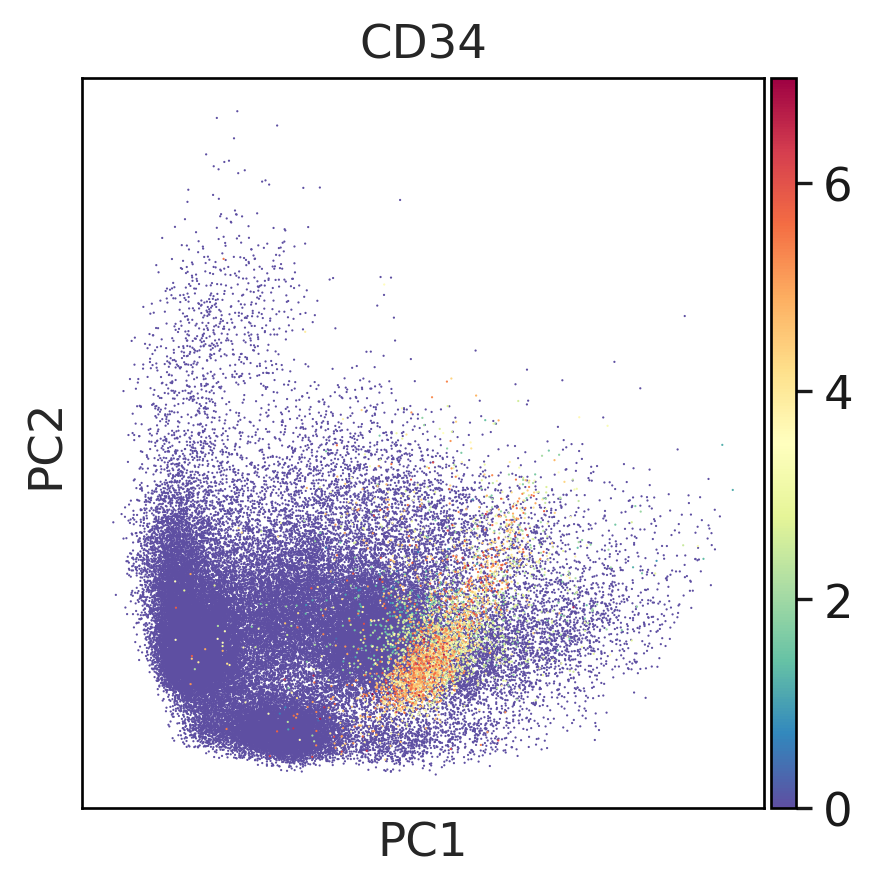

2024-08-23 13:19:41,197 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


Running Harmony


2024-08-23 13:19:52,988 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-08-23 13:19:53,524 - harmonypy - INFO - Iteration 1 of 10
2024-08-23 13:20:40,227 - harmonypy - INFO - Iteration 2 of 10
2024-08-23 13:21:25,943 - harmonypy - INFO - Iteration 3 of 10
2024-08-23 13:22:15,737 - harmonypy - INFO - Iteration 4 of 10
2024-08-23 13:22:59,227 - harmonypy - INFO - Iteration 5 of 10
2024-08-23 13:23:44,133 - harmonypy - INFO - Iteration 6 of 10
2024-08-23 13:24:37,552 - harmonypy - INFO - Iteration 7 of 10
2024-08-23 13:25:24,949 - harmonypy - INFO - Iteration 8 of 10
2024-08-23 13:26:06,455 - harmonypy - INFO - Iteration 9 of 10
2024-08-23 13:26:42,939 - harmonypy - INFO - Iteration 10 of 10
2024-08-23 13:27:12,355 - harmonypy - INFO - Stopped before convergence


Computing Diffusion maps...
Determing nearest neighbor graph...


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


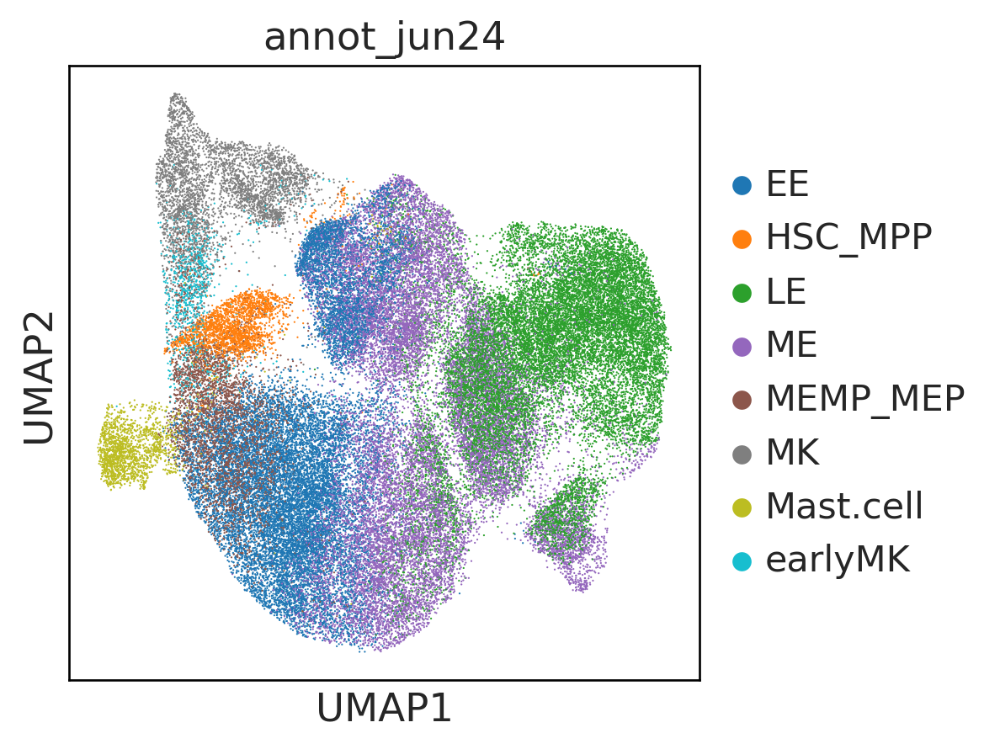

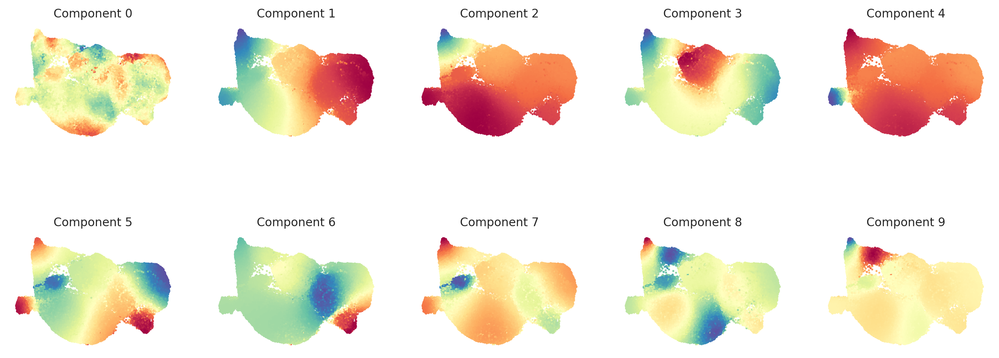

MAGIC imputation...


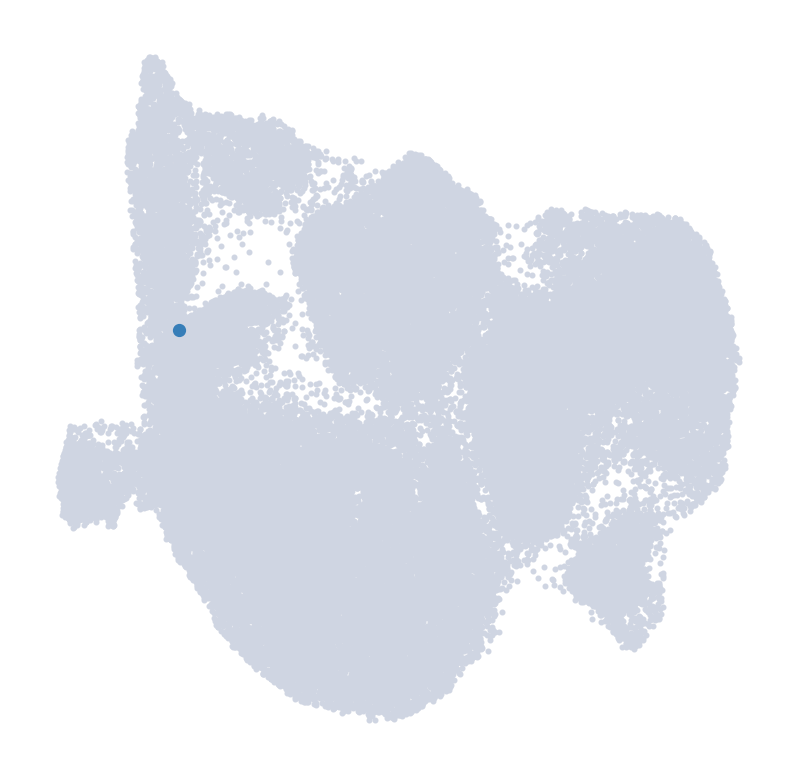

Using MY.200531.14816329_GCTGCTTCACTTCTGC-1 for cell type LE which is max in diffusion component 0.
Using liv28_TACGGGCAGATAACGT-1 for cell type MK which is min in diffusion component 0.
Using liv143_ATACTTCTCTCCGAAA-1 for cell type Mast.cell which is min in diffusion component 3.
Computing trajectory with Palantir...
Sampling and flocking waypoints...
Time for determining waypoints: 0.2709999124209086 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...


findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back t

Time for shortest paths: 1.878795572121938 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9989
Correlation at iteration 2: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


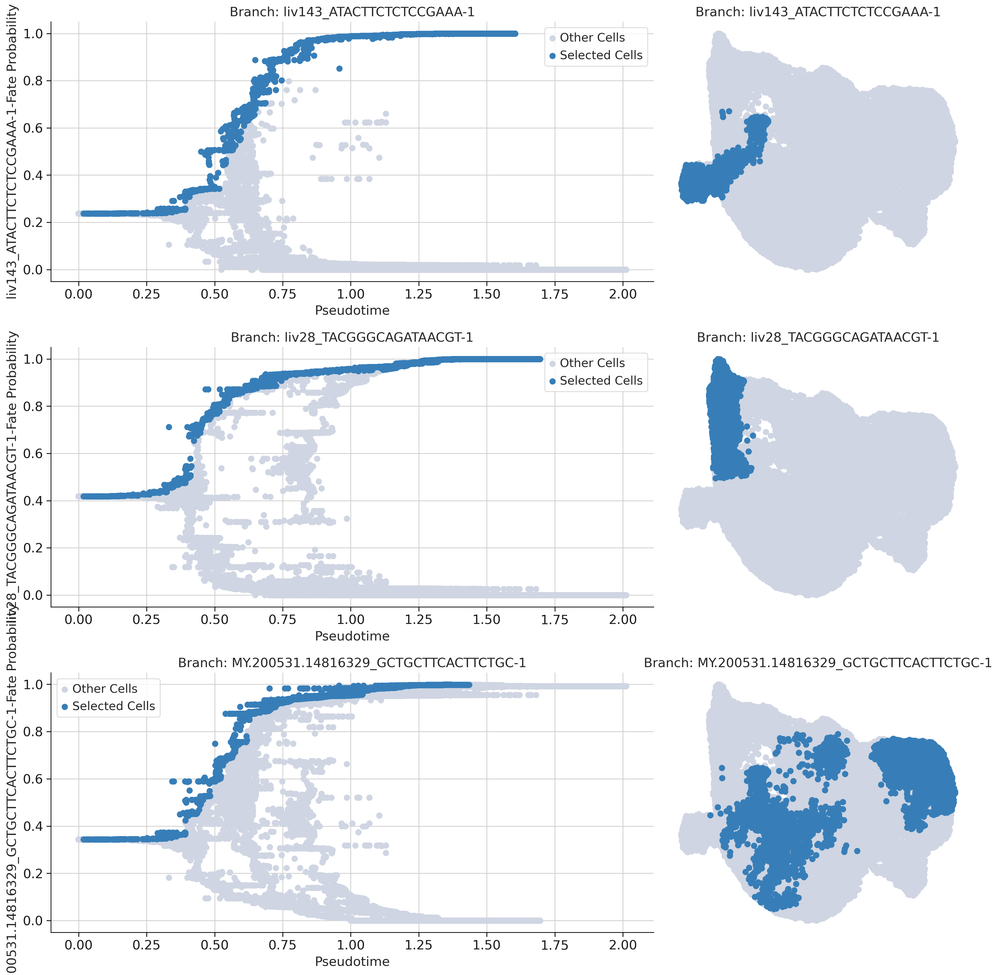

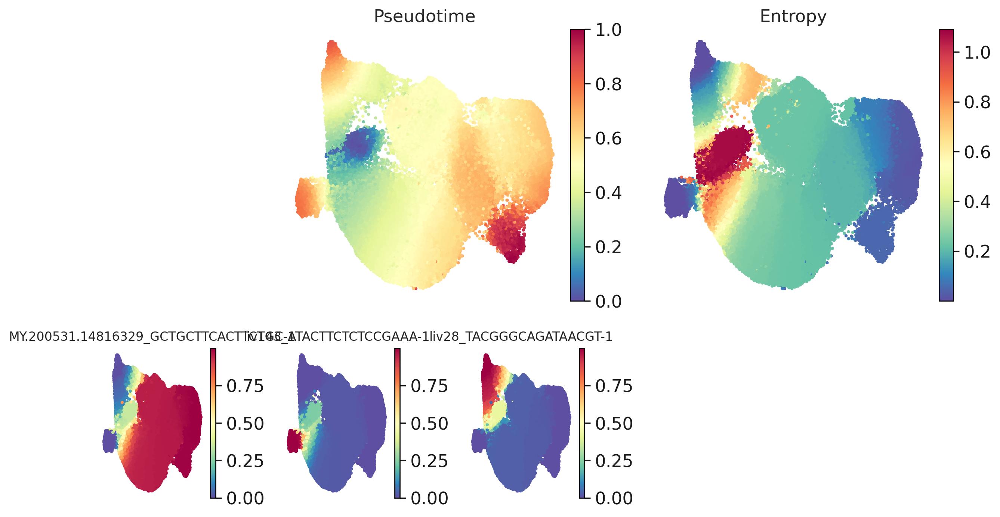

In [20]:
num_waypoints = 1200
runHarmony = True
harmonyVar = ['assay']
terminal_states = None
annotation_key = 'annot_jun24'
use_early_cell_as_start=False
n_components=10
n_comps=10

ad = adata_2n.copy()
#result_out_fp = '/home/jovyan/sc126/tmp_2312/1_palantir_output/diploid_haemTraj.csv' # main output is a csv file
result_out_fp = '/lustre/scratch125/casm/team274sb/mt22/Aneuploidy/MLDS_scRNAseq/Results/trajectoryProjection/fLiver2n_allcells/jul24/wholeTranscriptome/1_palantir_output/inhouse2n_MK.LE.Mast.Traj_2407.csv'

# define start cell
# eg. I defined start cells as HSC with highest expression of CD34
cd34_expr = ad.X[ad.obs['finalAnn_broad'] == 'HSC_MPP',np.where(ad.var.index == 'CD34')[0].tolist()[0]].toarray()
# Find cell ID with highest expression level for CD34
start_cell = ad.obs.loc[ad.obs['finalAnn_broad'] == 'HSC_MPP',:].index[cd34_expr.argmax()]


## Define terminal states
## Define terminal states
terminal_celltypes = ['LE','MK','Mast.cell']
determine_termState = True
palantir_results, ad = build_palantir_traj_v2(ad,ann_key=annotation_key,start_cell=start_cell,
                                           result_out_fp=result_out_fp,num_waypoints=num_waypoints,n_components=n_components,
                                           runHarmony=runHarmony,harmonyVar=harmonyVar,
                                              n_comps=n_comps,
                                              terminal_states=terminal_states,
                                              determine_termState = determine_termState,
                                              terminal_celltypes=terminal_celltypes)


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


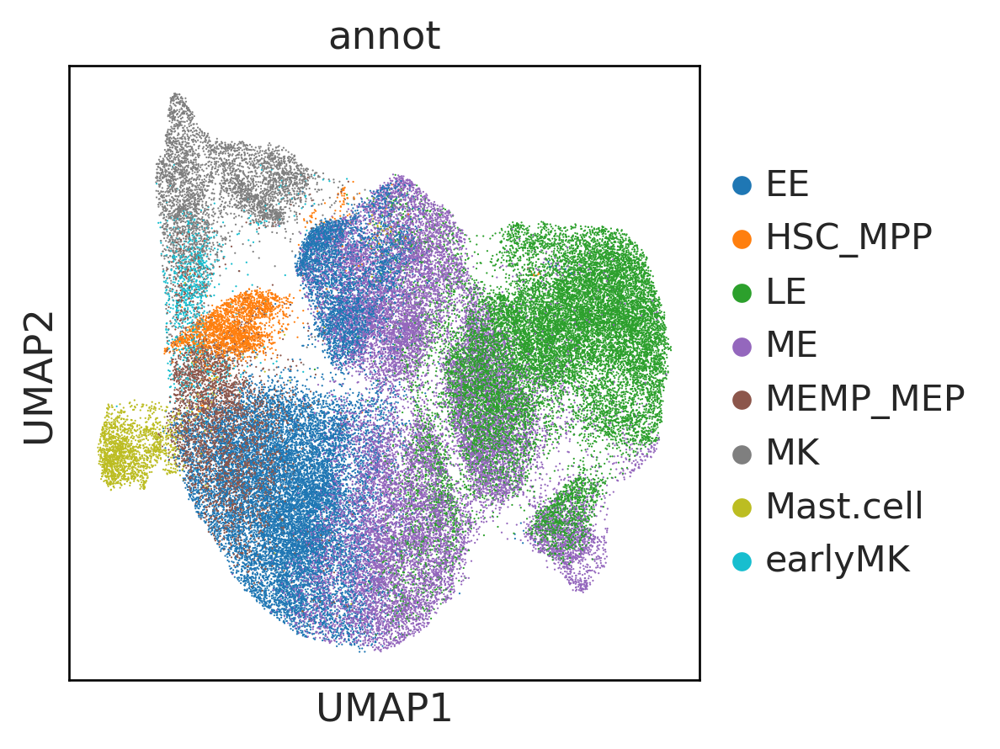

In [21]:
sc.pl.embedding(ad, basis='umap',color=['annot'],palette='tab10')

## Run Palantir on 2n - MK/EE/Mast lineage only

In [10]:
celltypes_toKeep = ['HSC_MPP','MEMP_MEP','EE','ME','LE',
                    'Mast.cell','earlyMK','MK']

adata_2n = adata[(adata.obs['Genotype'] == 'diploid') & 
                 (adata.obs['published_ann_2'] == 'NA') & 
                 (adata.obs['finalAnn_broad'].isin(celltypes_toKeep))
                      #(~adata_noCyc.obs['finalAnn_broad'].isin(['Hepatocyte','Endo','Kupffer.cell','Fibroblast','NPC','Mesenchyme']))
                      ]
print(adata_2n.obs.annot_mar24.value_counts())

ME           62266
LE           53135
EE           17198
MK            3416
MEMP_MEP      3187
HSC_MPP       1840
Mast.cell     1359
earlyMK        549
Name: annot_jan24, dtype: int64


In [51]:
adata_2n.X[1000:1005,1000:1005].toarray()

array([[0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0.]], dtype=float32)

Data processing...
Computing PCA...


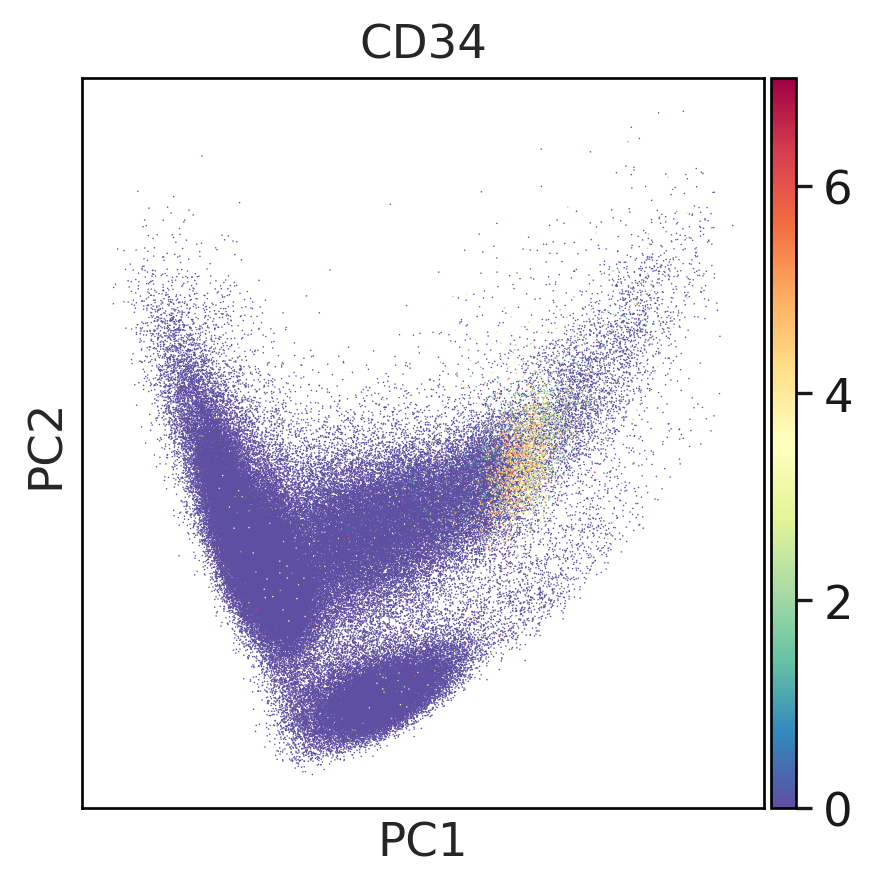

2024-04-21 12:18:52,226 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


Running Harmony


2024-04-21 12:48:27,774 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-04-21 12:48:28,836 - harmonypy - INFO - Iteration 1 of 10
2024-04-21 12:52:00,226 - harmonypy - INFO - Iteration 2 of 10
2024-04-21 12:55:33,607 - harmonypy - INFO - Iteration 3 of 10
2024-04-21 12:58:37,342 - harmonypy - INFO - Converged after 3 iterations


Computing Diffusion maps...
Determing nearest neighbor graph...


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/umap/d

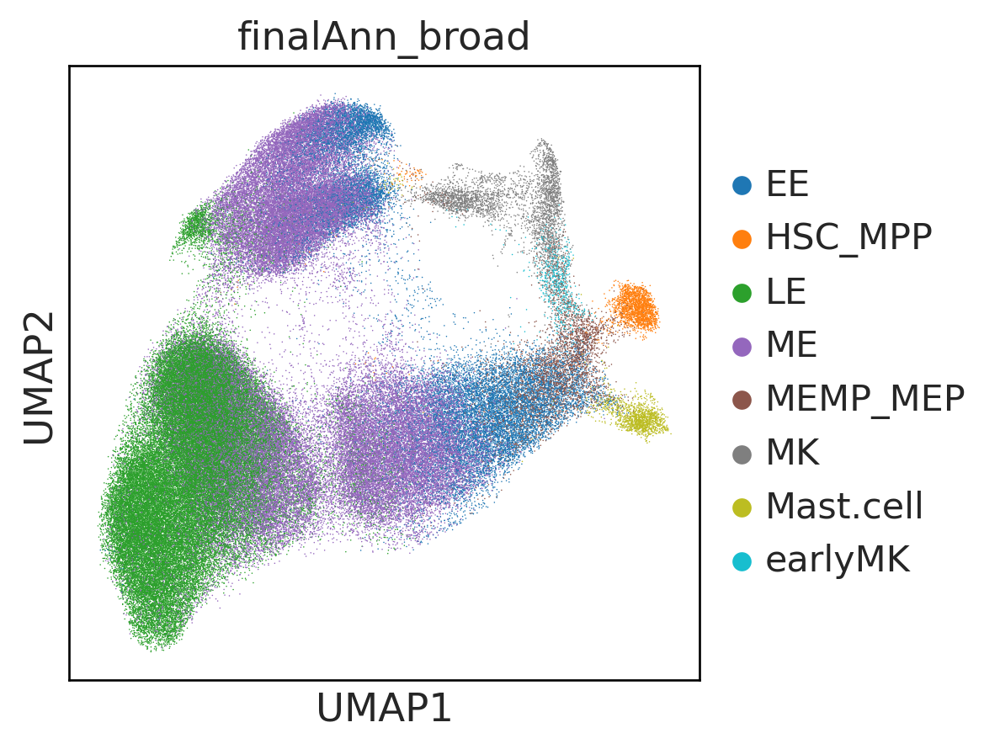

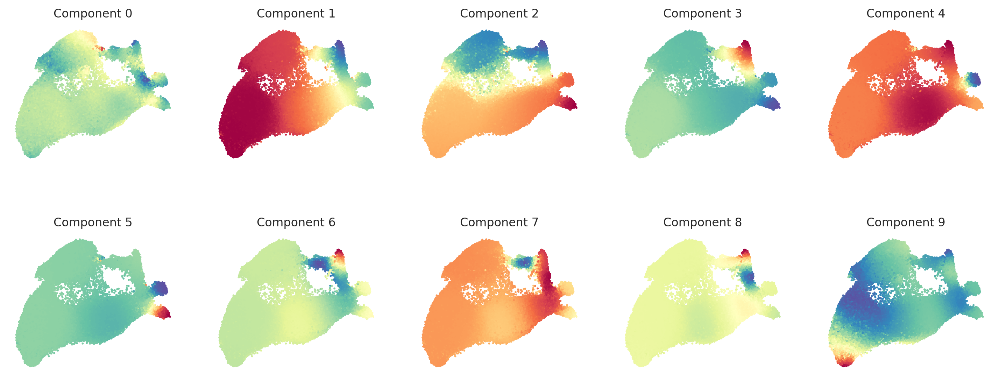

MAGIC imputation...


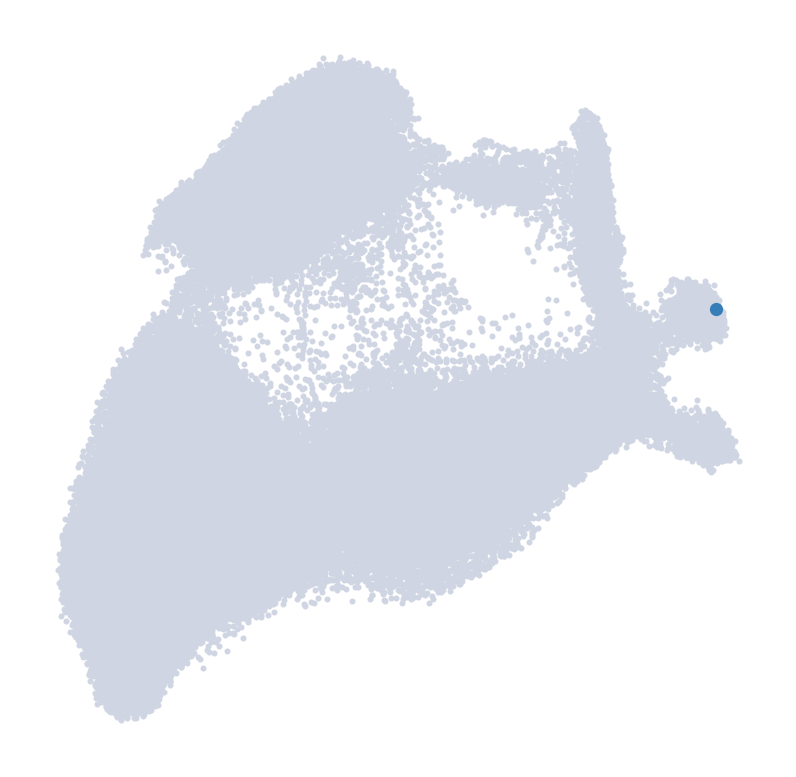

CellNotFoundException: No valid component found: ME Consider increasing the number of diffusion components ('n_components' in palantir.utils.run_diffusion_maps) or specify a 'fallback_seed' to determine an early cell based on reverse pseudotime starting from random non-ME cell.

In [11]:
num_waypoints = 1200
runHarmony = True
harmonyVar = ['donorID','Phase']
terminal_states = None
annotation_key = 'finalAnn_broad'
use_early_cell_as_start=False
n_components=10
#n_top_genes=2000

ad = adata_2n.copy()
#result_out_fp = '/home/jovyan/sc126/tmp_2312/1_palantir_output/diploid_haemTraj.csv' # main output is a csv file
result_out_fp = '/lustre/scratch125/casm/team274sb/mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/inhouse2n_MK.LE.Mast.Traj_2407.csv'

# define start cell
# eg. I defined start cells as HSC with highest expression of CD34
cd34_expr = ad.X[ad.obs['finalAnn_broad'] == 'HSC_MPP',np.where(ad.var.index == 'CD34')[0].tolist()[0]].toarray()
# Find cell ID with highest expression level for CD34
start_cell = ad.obs.loc[ad.obs['finalAnn_broad'] == 'HSC_MPP',:].index[cd34_expr.argmax()]

## Define terminal states
terminal_celltypes = ['LE','MK','Mast.cell']
determine_termState = True
palantir_results, ad = build_palantir_traj_v2(ad,ann_key=annotation_key,start_cell=start_cell,#n_top_genes=n_top_genes,
                                           result_out_fp=result_out_fp,num_waypoints=num_waypoints,n_components=n_components,
                                           runHarmony=runHarmony,harmonyVar=harmonyVar,
                                              terminal_states=terminal_states,
                                              determine_termState = determine_termState,
                                              terminal_celltypes=terminal_celltypes)


In [ ]:
gene_trends = palantir.presults.compute_gene_trends(
    ad,
    expression_key="MAGIC_imputed_data",
)
genes = ['CD34', 'MPO', 'GATA1', 'IRF8','HBB','PF4','KLF1','FLI1']
palantir.plot.plot_gene_trends(ad, genes)
plt.show()

MY.200531.14552810_ATGGATCCAGTCGGAA-1
[2024-02-01 20:36:46,840] [INFO    ] Using covariance function Matern52(ls=10.0).
MY.200531.14552810_CAGGCCAGTCGCATTA-1
[2024-02-01 20:36:55,847] [INFO    ] Using covariance function Matern52(ls=10.0).
liv27_TCCGATCCATAATGAG-1
[2024-02-01 20:37:01,013] [INFO    ] Using covariance function Matern52(ls=10.0).


## Run Palantir on T21

In [46]:
celltypes_toKeep_t21 = ['HSC_MPP','MEMP_MEP','EE','ME','LE',
                    'Mast.cell','earlyMK','MK',
                   #'LMPP_ELP','pro.B.cell','pre.B.cell','B.cell',
                    'CMP_GMP','proMono','MOP','Monocyte']#,'Macrophage']

In [47]:
adata_T21 = adata[(adata.obs['Genotype'] == 'T21') & 
                       (adata.obs['annot_mar24'].isin(celltypes_toKeep_t21))
                      #(~adata_noCyc.obs['finalAnn_broad'].isin(['Hepatocyte','Endo','Kupffer.cell','Fibroblast','NPC','Mesenchyme']))
                      ]


In [48]:
adata_T21.obs['finalAnn_broad'][adata_T21.obs['Genotype'] == 'T21'].value_counts()

ME            67037
LE            63716
EE            44211
MEMP_MEP       3741
MK             2787
HSC_MPP        1724
Mast.cell      1168
Monocyte        560
earlyMK         472
pre.B.cell      439
CMP_GMP         239
pro.B.cell      207
B.cell          141
LMPP_ELP         75
proMono          33
Name: finalAnn_broad, dtype: int64

Data processing...
Computing PCA...


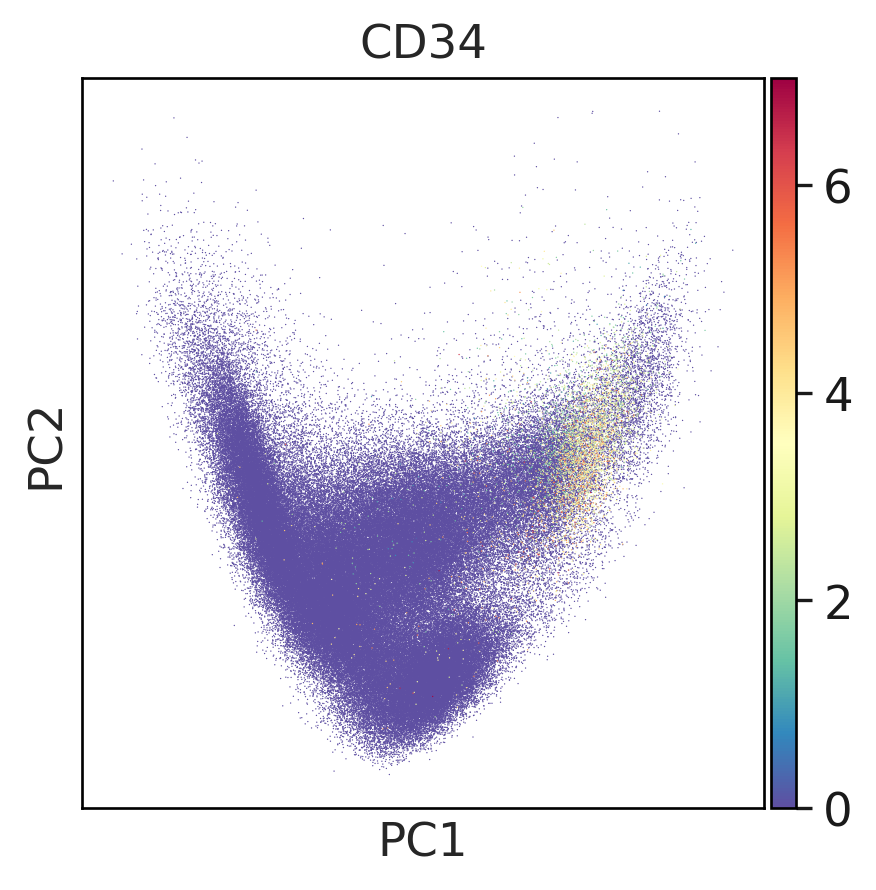

2024-04-21 09:22:30,987 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


Running Harmony


2024-04-21 09:57:13,274 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-04-21 09:57:14,253 - harmonypy - INFO - Iteration 1 of 10
2024-04-21 10:01:12,235 - harmonypy - INFO - Iteration 2 of 10
2024-04-21 10:05:10,145 - harmonypy - INFO - Iteration 3 of 10
2024-04-21 10:09:07,547 - harmonypy - INFO - Iteration 4 of 10
2024-04-21 10:12:36,455 - harmonypy - INFO - Iteration 5 of 10
2024-04-21 10:15:13,141 - harmonypy - INFO - Converged after 5 iterations


Computing Diffusion maps...
Determing nearest neighbor graph...


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


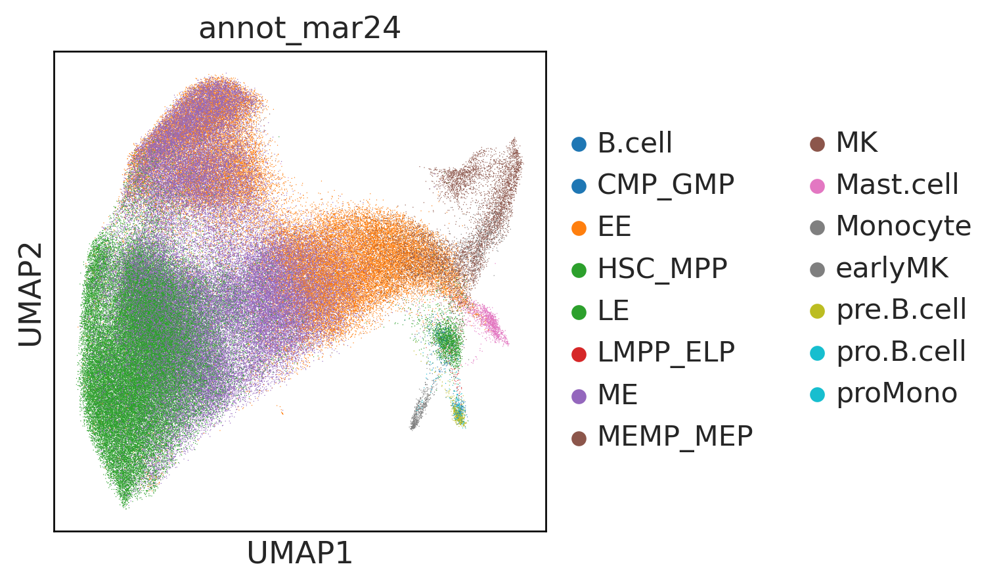

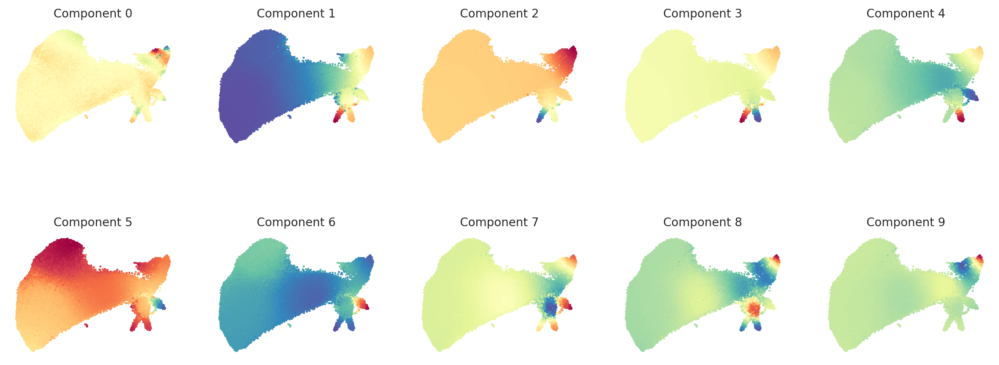

MAGIC imputation...


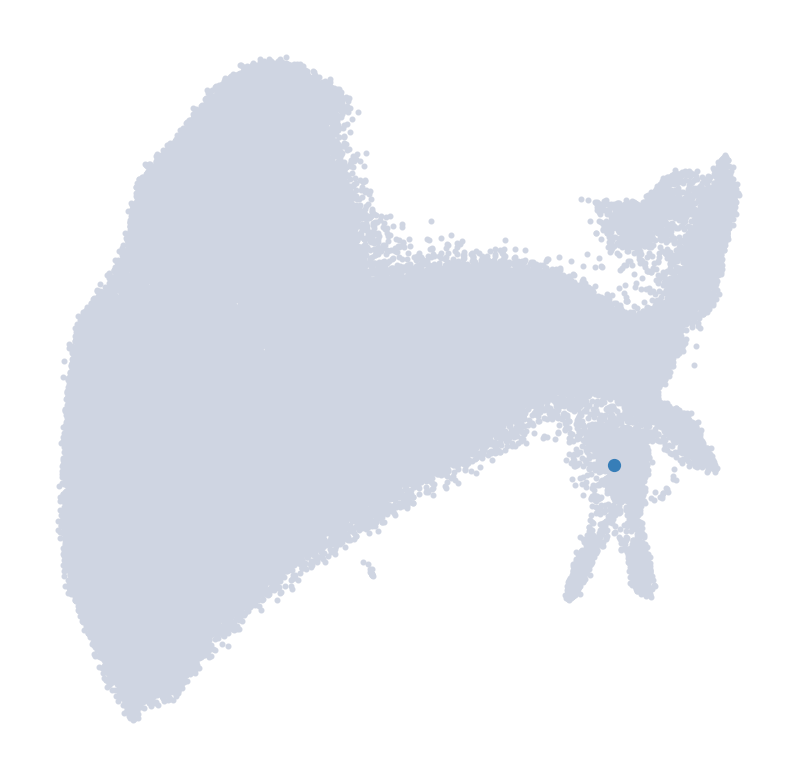

Using MY.200531.14635739_GAAGCGACACAATGAA-1 for cell type Monocyte which is max in diffusion component 0.
Using MY.200531.14665736_CTCCCTCAGGTAAACT-1 for cell type LE which is min in diffusion component 0.
Using MY.200531.14665737_ACCAAACAGCTTACGT-1 for cell type MK which is max in diffusion component 1.
Using MY.200531.14635739_AAACCCATCTTCCCGA-1 for cell type Mast.cell which is min in diffusion component 3.


CellNotFoundException: No valid component found: B.cell Consider increasing the number of diffusion components ('n_components' in palantir.utils.run_diffusion_maps) or specify a 'fallback_seed' to determine an early cell based on reverse pseudotime starting from random non-B.cell cell.

In [49]:
num_waypoints = 1200
runHarmony = True
harmonyVar = ['donorID','Phase']
terminal_states = None
annotation_key = 'annot_mar24'
use_early_cell_as_start=True
n_components=10

ad_T21 = adata_T21.copy()
#result_out_fp = '/home/jovyan/sc126/tmp_2312/1_palantir_output/T21_haemTraj.csv' # main output is a csv file
result_out_fp = '/lustre/scratch125/casm/team274sb/mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/T21_haemTraj_withB_2404.csv'
# define start cell
# eg. I defined start cells as HSC with highest expression of CD34
cd34_expr = ad_T21.X[ad_T21.obs['finalAnn_broad'] == 'HSC_MPP',np.where(ad_T21.var.index == 'CD34')[0].tolist()[0]].toarray()
# Find cell ID with highest expression level for CD34
start_cell = ad_T21.obs.loc[ad_T21.obs['finalAnn_broad'] == 'HSC_MPP',:].index[cd34_expr.argmax()]

## Define terminal states
terminal_celltypes = ['Monocyte','LE','MK','Mast.cell','B.cell']
determine_termState = True
palantir_results, ad_T21 = build_palantir_traj_v2(ad_T21,ann_key=annotation_key,start_cell=start_cell,
                                           result_out_fp=result_out_fp,num_waypoints=num_waypoints,n_components=n_components,
                                           runHarmony=runHarmony,harmonyVar=harmonyVar,
                                              terminal_states=terminal_states,
                                              determine_termState = determine_termState,
                                              terminal_celltypes=terminal_celltypes)


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


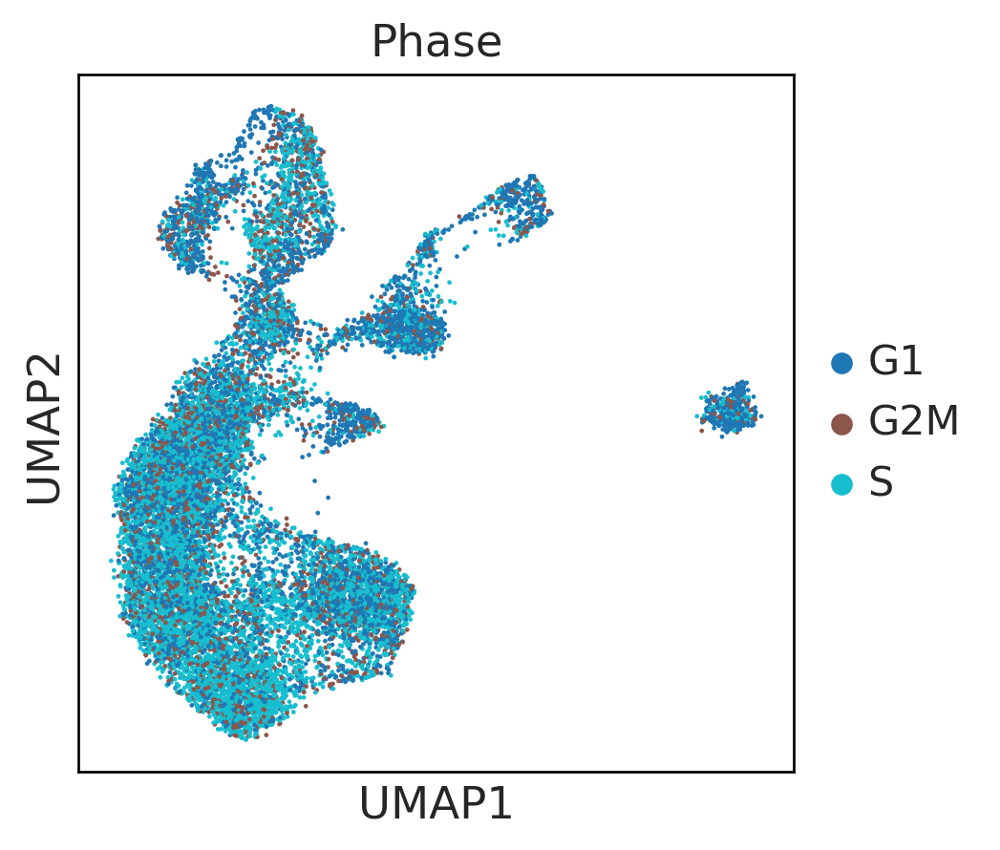

In [21]:
sc.pl.embedding(ad_T21, basis='umap',color=['Phase'],palette='tab10')

# Prep data for Genes2Genes

## fLiver_2n

In [22]:
dip_traj = pd.read_csv('/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/inhouse2n_haemTraj_assigned.csv')
## MK trajectory cells are those assigned to MK branch (in branch2 column)
dip_traj_mk = dip_traj.loc[dip_traj.branch3 == 'MK']
dip_traj_mk = dip_traj_mk.set_index(dip_traj_mk.cellID)
# only keep cells assigned to MK lineage
cells_toKeep = dip_traj_mk.cellID.to_list()

# Subset anndata for G2G
ad_2n_mk = adata[(adata.obs['cellID'].isin(cells_toKeep))]
ad_2n_mk.obs['time'] = dip_traj_mk.loc[ad_2n_mk.obs.index.to_list(),'palantir_pseudotime']

/tmp/ipykernel_5762/716134504.py:1: DtypeWarning: Columns (40,41,42,44,46,47,50,51) have mixed types. Specify dtype option on import or set low_memory=False.
  dip_traj = pd.read_csv('/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/inhouse2n_haemTraj_assigned.csv')
/tmp/ipykernel_5762/716134504.py:10: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  ad_2n_mk.obs['time'] = dip_traj_mk.loc[ad_2n_mk.obs.index.to_list(),'palantir_pseudotime']


In [23]:
ad_2n_mk.write_h5ad('/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/fLiver_inhouse2n_MKlin_forG2G.h5ad',compression='gzip')
ad_2n_mk.obs.to_csv('/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/fLiver_inhouse2n_MKlin_forG2G_mdat.csv')

## fLiver_T21

In [18]:
t21_traj = pd.read_csv('/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/T21_haemTraj_noB_assigned.csv')
## MK trajectory cells are those assigned to MK branch (in branch2 column)
t21_traj_mk = t21_traj.loc[t21_traj.branch3 == 'MK']
t21_traj_mk = t21_traj_mk.set_index(t21_traj_mk.cellID)
# only keep cells assigned to MK lineage
cells_toKeep = t21_traj_mk.cellID.to_list()

# Subset anndata for G2G
ad_T21_mk = adata[(adata.obs['cellID'].isin(cells_toKeep))]
ad_T21_mk.obs['time'] = t21_traj_mk.loc[ad_T21_mk.obs.index.to_list(),'palantir_pseudotime']

/tmp/ipykernel_5762/4010301495.py:1: DtypeWarning: Columns (39,40,41,42) have mixed types. Specify dtype option on import or set low_memory=False.
  t21_traj = pd.read_csv('/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/T21_haemTraj_noB_assigned.csv')
/tmp/ipykernel_5762/4010301495.py:10: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  ad_T21_mk.obs['time'] = t21_traj_mk.loc[ad_T21_mk.obs.index.to_list(),'palantir_pseudotime']


In [19]:
ad_T21_mk.write_h5ad('/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/fLiverT21_MKlin_forG2G.h5ad',compression='gzip')
ad_T21_mk.obs.to_csv('/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/fLiverT21_MKlin_forG2G_mdat.csv')

/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


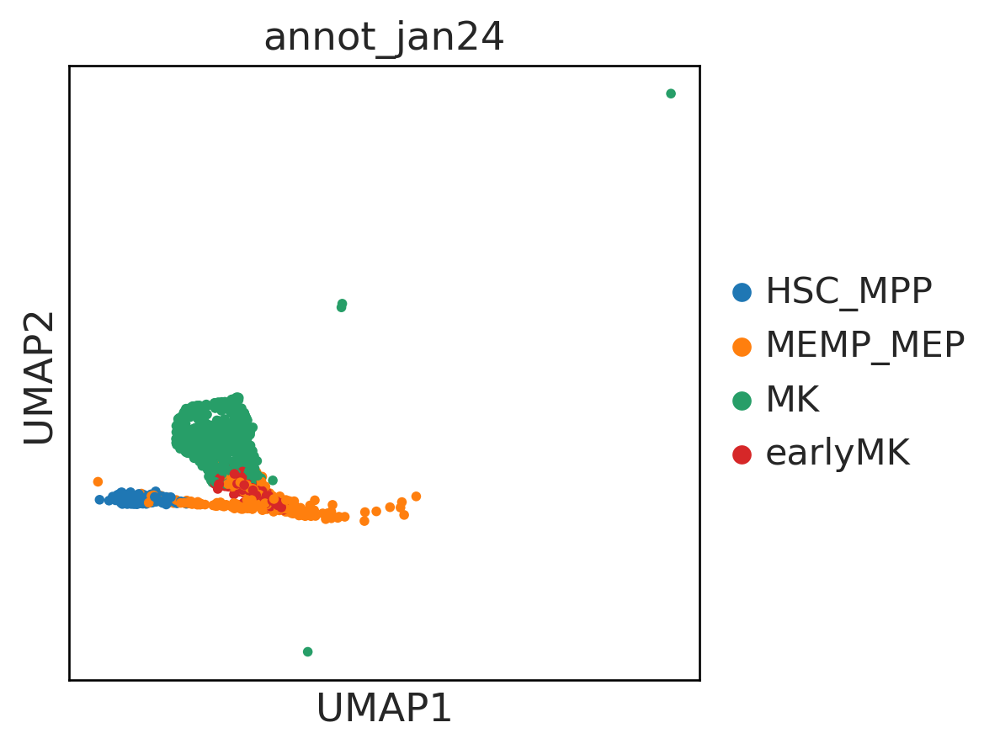

In [21]:
sc.pl.umap(ad_T21_mk,color=['annot_jan24'])

In [ ]:
ad_mk.obs['time'] = mk_dip_traj.loc[:,'pseudotime'][match(ad_mk.obs.loc[:,'cellID'],mk_dip_traj.index)].tolist()
ad_mk.obs['time'] = ad_mk.obs['palantir_pseudotime']


In [9]:
geno = 'diploid_fLiver_1500wp_231022'
main_outDir = '/lustre/scratch126/casm/team274sb/mt22/tmp_2312/1_palantir_output/diploid_haemTraj.csv'

ad = sc.read_h5ad(f'{main_outDir}/MKlineage_{geno}_ad.h5ad')
liv_dip_traj = pd.read_csv(f'{main_outDir}/MKlineage_{geno}.csv')
liv_dip_traj.index = liv_dip_traj.iloc[:,0]
liv_dip_traj.head()
# Find MK terminal state
print(liv_dip_traj.columns.values.tolist())
mk_term_state = ad.obs.loc[ad.obs.index == 'FCAImmP7352195_CTGAAGTAGGTCATCT-1','finalAnn_broad']

In [25]:
### Branch selection
masks = palantir.presults.select_branch_cells(ad, eps=0)
palantir.plot.plot_branch_selection(ad)
plt.show()

### Extract Palantir results
mask_output = pd.DataFrame.from_records(ad.obsm['branch_masks'],index=ad.obsm['branch_masks'].index)

mdat = pd.merge(ad.obs,mask_output,left_index=True, right_index=True)
mdat = pd.merge(mdat,liv_dip_traj,left_index=True, right_index=True)


FCAImmP7352195_CTGAAGTAGGTCATCT-1    Megakaryocyte
Name: finalAnn_broad, dtype: category
Categories (5, object): ['EE', 'HSC_MPP', 'MEMP', 'Mast.cell', 'Megakaryocyte']

In [37]:
# only keep cells assigned to MK lineage
cells_toKeep = mdat.loc[mdat[f'{mk_term_state.index.tolist()[0]}_x'] == True,'cellID'].to_list()

['4834STDY7002878_AGGTCCGAGGCTCATT-1',
 '4834STDY7002878_CAAGGCCAGCCAGTAG-1',
 '4834STDY7002878_CAGATCACAGGGAGAG-1',
 '4834STDY7002878_CCACGGAAGCATGGCA-1']

Data processing...


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:524: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key_n_counts] = counts_per_cell


Computing PCA...


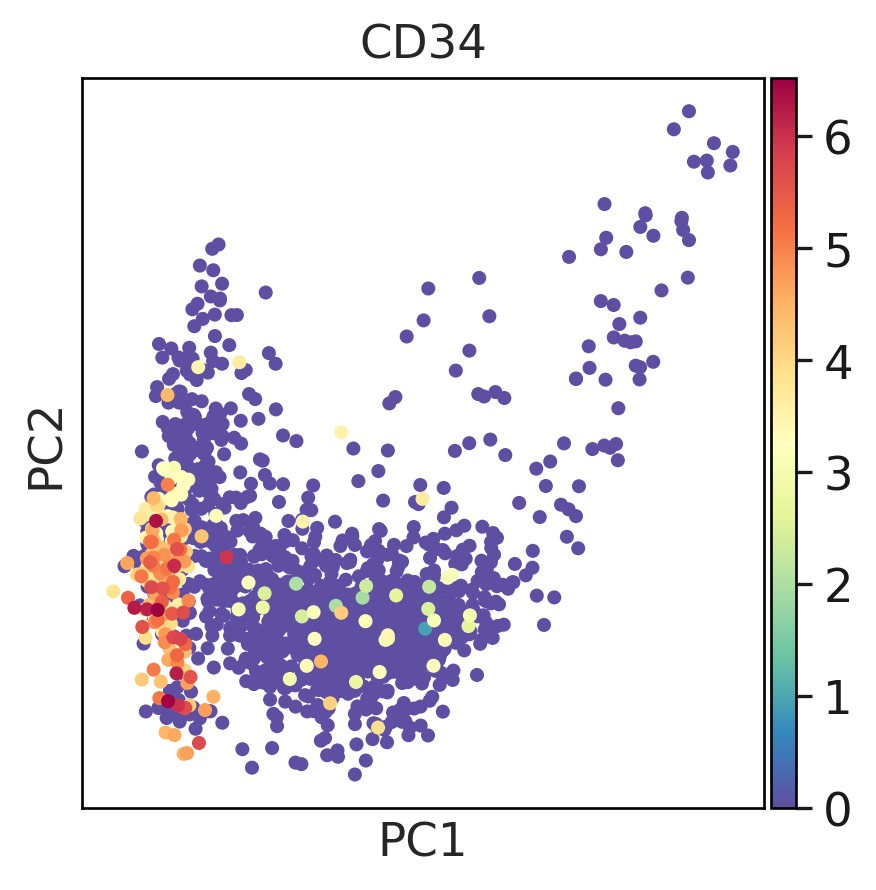

Computing Diffusion maps...
Determing nearest neighbor graph...


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


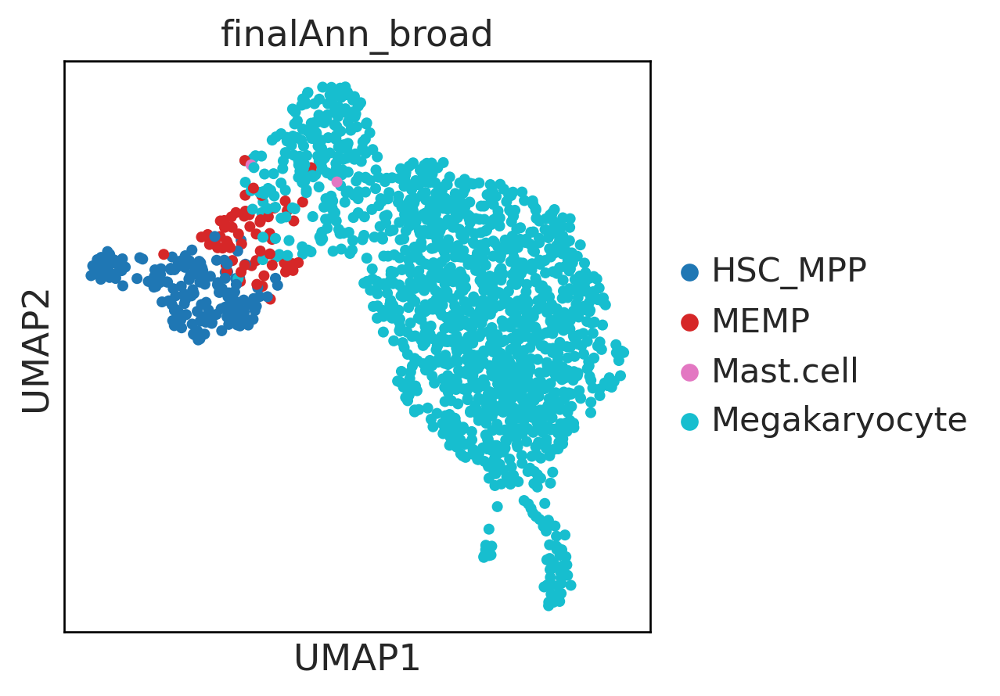

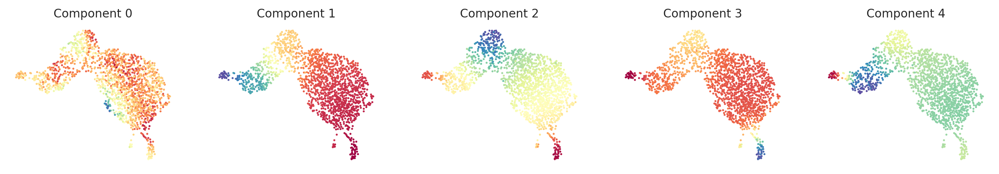

MAGIC imputation...


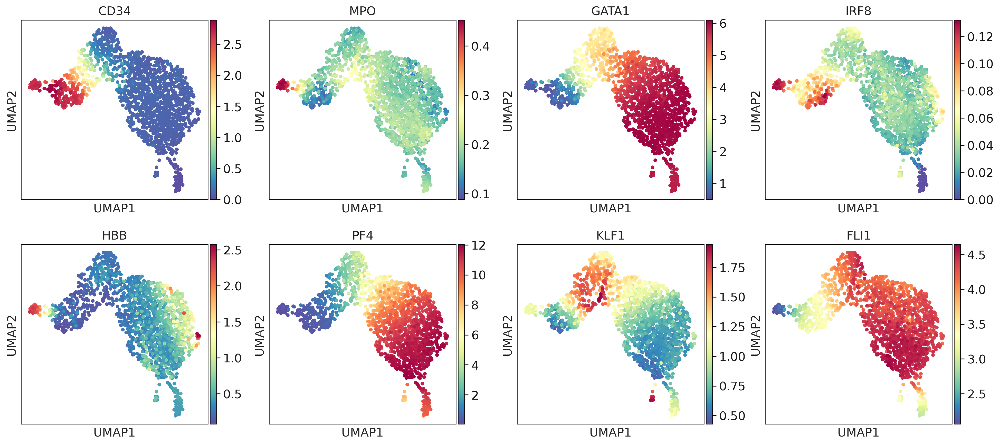

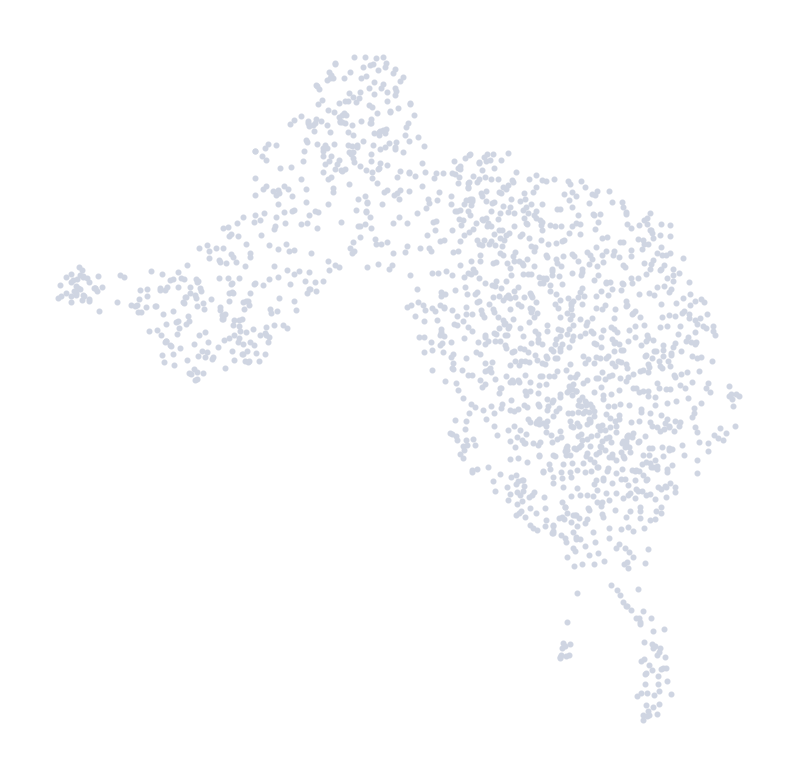

Computing trajectory with Palantir...
Sampling and flocking waypoints...
Time for determining waypoints: 0.006393218040466308 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...


findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back t

Time for shortest paths: 0.08716477553049723 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


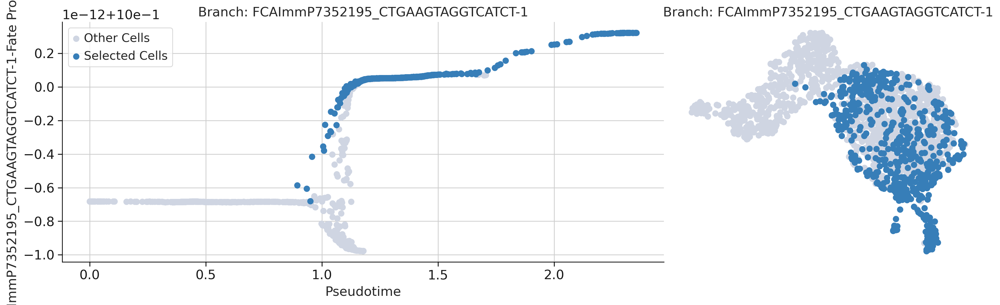

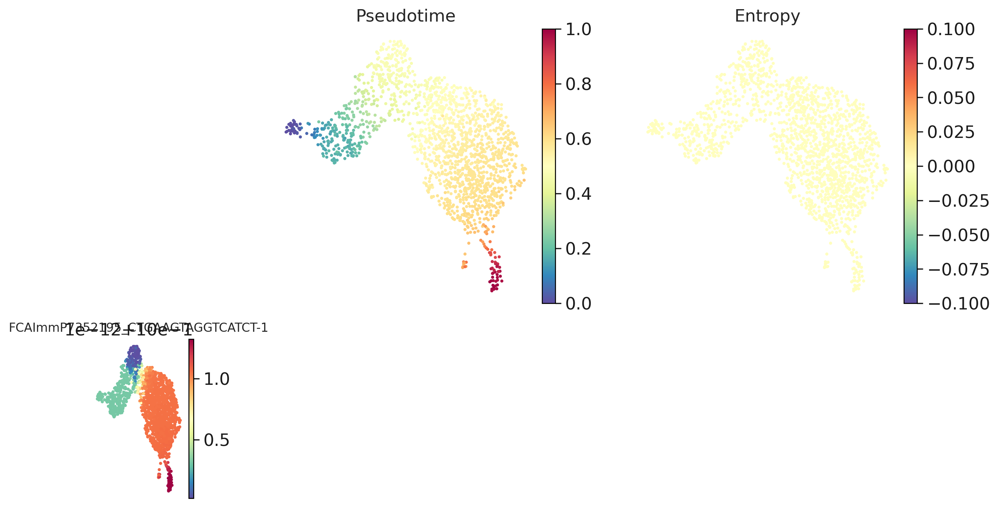

In [48]:
## Construct pseudotime for MK lineage only for genes2genes

#mk_2n_ad = adata[(adata.obs['Phase'] == 'G1') & (adata.obs['cellID'].isin(liv_dip_traj.iloc[np.where(liv_dip_traj.branch2 == 'Megakaryocyte')].index.tolist()))]
mk_2n_ad = adata[(adata.obs['Phase'] == 'G1') & (adata.obs['cellID'].isin(cells_toKeep))]
ad_mk = mk_2n_ad
num_waypoints = 1200
geno = 'diploid_fLiver2nMK_1200wp_sept23'
result_out_fp = f'/lustre/scratch125/casm/team274sb/mt22/Aneuploidy/MLDS_scRNAseq/6_MK_lineage/sept23/palantir_output/fLiver2n_allMK/MKlineage_{geno}.csv'
sub_outdir = '/lustre/scratch125/casm/team274sb/mt22/Aneuploidy/MLDS_scRNAseq/6_MK_lineage/sept23/palantir_output/fLiver2n_allMK'
if not os.path.isdir(sub_outdir):
    os.makedirs(sub_outdir)
# Get the index for the cell with the higest expression of CD34
cd34_expr = ad_mk.X[ad_mk.obs['finalAnn_broad'] == 'HSC_MPP',np.where(ad.var.index == 'CD34')[0].tolist()[0]].toarray()
# Find cell ID with highest expression level for CD34
start_cell = ad_mk.obs.loc[ad_mk.obs['finalAnn_broad'] == 'HSC_MPP',:].index[cd34_expr.argmax()]
# Provide previous terminal cell state
terminal_states = mk_term_state.index.tolist()
mk_dip_traj,ad_mk = build_palantir_traj_v2(ad_mk,ann_key='finalAnn_broad',start_cell=start_cell,result_out_fp=result_out_fp,n_top_genes=1000,terminal_states=terminal_states)



In [52]:
# Save h5ad fLiver_2n_MK object with pseudotime for Genes2Genes
ad_mk.obs['time'] = mk_dip_traj.loc[:,'pseudotime'][match(ad_mk.obs.loc[:,'cellID'],mk_dip_traj.index)].tolist()
ad_mk.obs['time'] = ad_mk.obs['palantir_pseudotime']
ad_mk.write_h5ad('/lustre/scratch125/casm/team274sb/mt22/Aneuploidy/MLDS_scRNAseq/6_MK_lineage/sept23/palantir_output/fLiver2n_allMK/fLiver2n_MKlin_forG2G.h5ad',compression='gzip')
ad_mk.obs.to_csv('/lustre/scratch125/casm/team274sb/mt22/Aneuploidy/MLDS_scRNAseq/6_MK_lineage/sept23/palantir_output/fLiver2n_allMK/fLiver2n_MKlin_forG2G_mdat.csv')

In [62]:
mk_dip_traj

,FCAImmP7352195_CTGAAGTAGGTCATCT-1
4834STDY7002878_ACTATCTTCTTATCTG-1,1.0
4834STDY7002878_AGGTCCGAGGCTCATT-1,1.0
4834STDY7002878_CAAGGCCAGCCAGTAG-1,1.0
4834STDY7002878_CAGATCACAGGGAGAG-1,1.0
4834STDY7002878_CCACGGAAGCATGGCA-1,1.0
...,...
FCAImmP7579223_TCAGATGTCGTTTATC-1,1.0
FCAImmP7579223_TGGGCGTGTAGAGCTG-1,1.0
FCAImmP7579223_TGTATTCCAGACTCGC-1,1.0
FCAImmP7579223_TTCGAAGAGGCTAGGT-1,1.0


Data processing...


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:524: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key_n_counts] = counts_per_cell


Computing PCA...


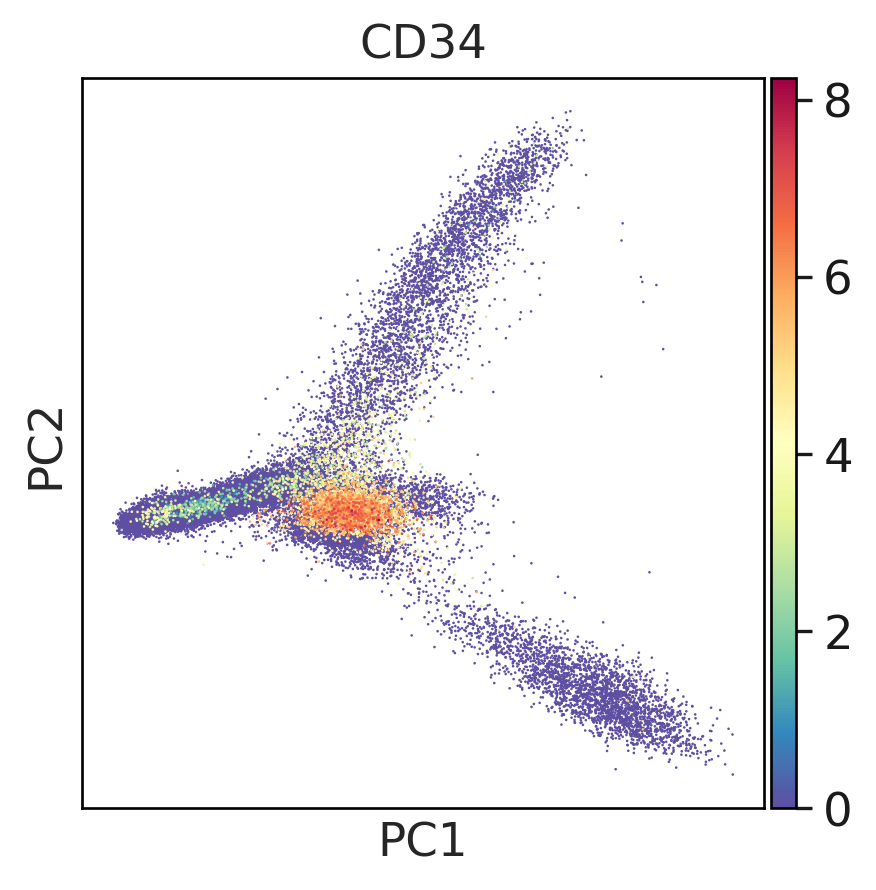

2023-12-29 17:59:55,936 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


Running Harmony


2023-12-29 18:01:06,411 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-12-29 18:01:06,830 - harmonypy - INFO - Iteration 1 of 10
2023-12-29 18:01:58,525 - harmonypy - INFO - Iteration 2 of 10
2023-12-29 18:02:50,329 - harmonypy - INFO - Iteration 3 of 10
2023-12-29 18:03:41,432 - harmonypy - INFO - Converged after 3 iterations


In [62]:
ad = adata_2n
num_waypoints = 1200
runHarmony = True
harmonyVar = ['donorID','Phase']
terminal_states = None
annotation_key = 'finalAnn_broad'
n_top_genes=1500


print('Data processing...')
# Normalisation
sc.pp.normalize_per_cell(ad)
# log1p transformation, palantir function uses a pseudocount of 0.1 instead of 1.
palantir.preprocess.log_transform(ad)

# Select highly variable genes
sc.pp.highly_variable_genes(ad, n_top_genes=n_top_genes)


### PCA
print('Computing PCA...')
sc.pp.pca(ad)
sc.pl.pca_scatter(ad, color='CD34')

if runHarmony:
    ### Harmony
    print('Running Harmony')
    sc.external.pp.harmony_integrate(ad,harmonyVar)

    

In [63]:
ad

AnnData object with n_obs × n_vars = 49730 × 25937
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'S.Score', 'G2M.Score', 'Phase', 'percent.mt', 'scrubScore', 'scrubSim1', 'scrubSim2', 'fracBadClust', 'postSoupX_nCount', 'cellID', 'preSoupX_nCount', 'channelID', 'published_ann', 'rownames', 'RNA_snn_res.1', 'seurat_clusters', 'LR_predicted_label_kidney', 'LR_softmax_predicted_label_kidney', 'LR_predicted_label_adrenal', 'LR_softmax_predicted_label_adrenal', 'LR_predicted_label_liver', 'LR_softmax_predicted_label_liver', 'donorID', 'Sex', 'assay', 'termination', 'gestationalAge', 'Genotype', 'finalAnn', 'published_ann_2', 'finalAnn_broad', 'sorting_strategy', 'RNA_snn_res.10', 'PDID', 'Tissue', 'may23_annot', 'celltype_LR', 'LR_celltype.ClusterIDs', 'highest_LR_LLH.ClusterIDs', 'finalAnn_refined_v1', 'broadLineage', 'annot', 'finalAnn_broad_factor', 'percent.hb', 'percent.hep', 'annot_sept23', 'annot_jul23', 'tmp', 'n_counts'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expe

In [64]:
n_components=10
### Compute Diffusion maps
print('Computing Diffusion maps...') 
# Run diffusion maps
if runHarmony:
    dm_res = palantir.utils.run_diffusion_maps(ad, n_components=n_components,pca_key="X_pca_harmony")
    sc.pp.neighbors(ad,use_rep='X_pca_harmony')     

else:
    dm_res = palantir.utils.run_diffusion_maps(ad, n_components=n_components)
    sc.pp.neighbors(ad)  


Computing Diffusion maps...
Determing nearest neighbor graph...


In [72]:
# The low dimensional embeddeing of the data is estimated based on the eigen gap using the following function
ms_data = palantir.utils.determine_multiscale_space(ad)

In [89]:
ad
ad.obsm['DM_EigenVectors_multiscaled'].shape

AnnData object with n_obs × n_vars = 49730 × 25937
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'S.Score', 'G2M.Score', 'Phase', 'percent.mt', 'scrubScore', 'scrubSim1', 'scrubSim2', 'fracBadClust', 'postSoupX_nCount', 'cellID', 'preSoupX_nCount', 'channelID', 'published_ann', 'rownames', 'RNA_snn_res.1', 'seurat_clusters', 'LR_predicted_label_kidney', 'LR_softmax_predicted_label_kidney', 'LR_predicted_label_adrenal', 'LR_softmax_predicted_label_adrenal', 'LR_predicted_label_liver', 'LR_softmax_predicted_label_liver', 'donorID', 'Sex', 'assay', 'termination', 'gestationalAge', 'Genotype', 'finalAnn', 'published_ann_2', 'finalAnn_broad', 'sorting_strategy', 'RNA_snn_res.10', 'PDID', 'Tissue', 'may23_annot', 'celltype_LR', 'LR_celltype.ClusterIDs', 'highest_LR_LLH.ClusterIDs', 'finalAnn_refined_v1', 'broadLineage', 'annot', 'finalAnn_broad_factor', 'percent.hb', 'percent.hep', 'annot_sept23', 'annot_jul23', 'tmp', 'n_counts', 'palantir_pseudotime', 'palantir_entropy'
    var: 'vs

In [87]:


start_cell = palantir.utils.early_cell(ad, "HSC_MPP", "annot_sept23")

CellNotFoundException: No valid component found: HSC_MPP Consider increasing the number of diffusion components ('n_components' in palantir.utils.run_diffusion_maps) or specify a 'fallback_seed' to determine an early cell based on reverse pseudotime starting from random non-HSC_MPP cell.

/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


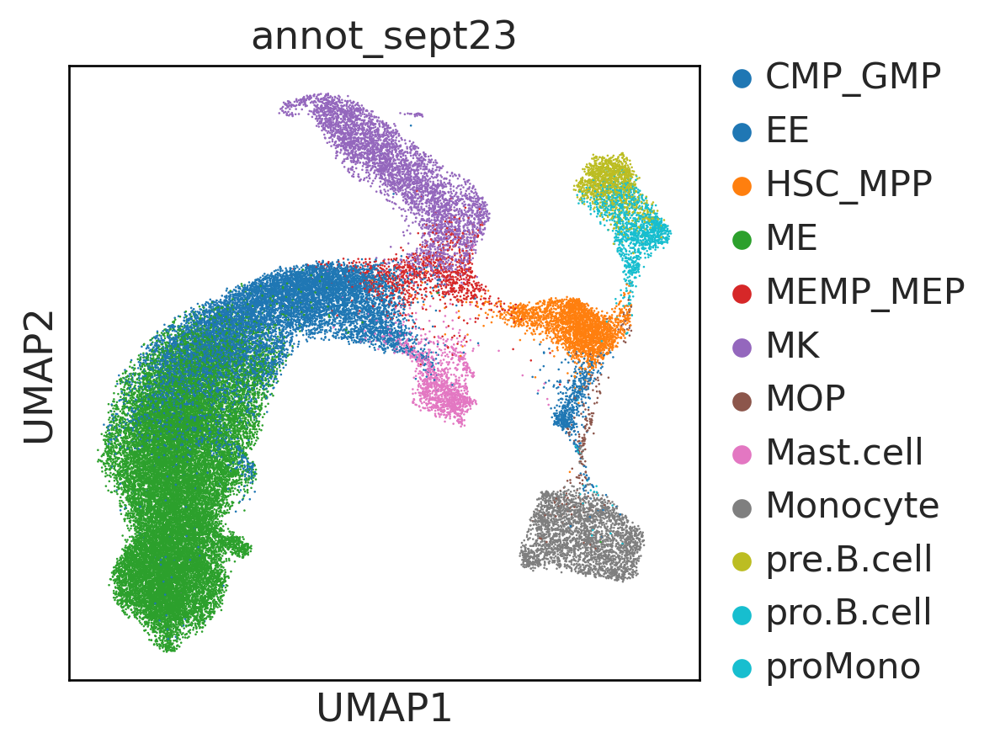

In [70]:
### Visualization
# Recommend using FDG, but UMAP is a good alternative for visualization
sc.pp.neighbors(ad, n_pcs = 30, use_rep = 'X_pca_harmony')
sc.tl.umap(ad)
# Use scanpy functions to visualize umaps or FDL
sc.pl.embedding(ad, basis='umap',color='annot_sept23',palette='tab10')



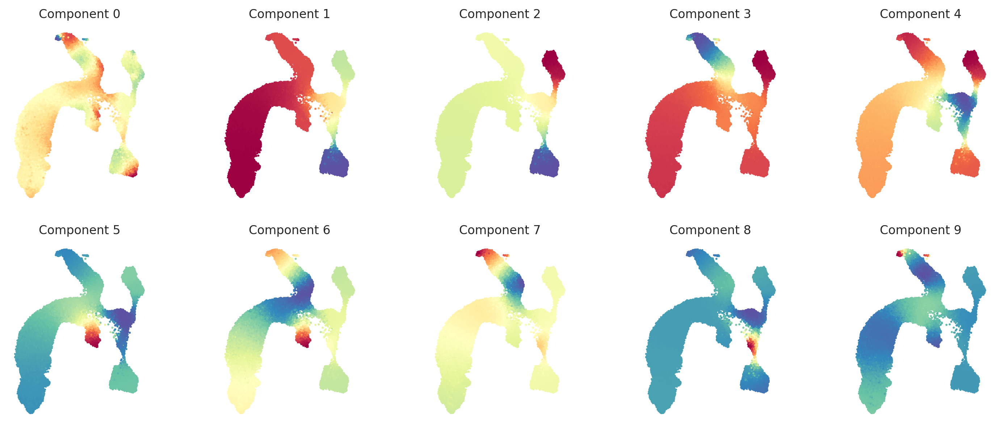

In [76]:
# Diffusion map visualisation
palantir.plot.plot_diffusion_components(ad)
plt.show()

In [80]:
help(palantir.core.run_palantir)

Help on function run_palantir in module palantir.core:

run_palantir(data: Union[pandas.core.frame.DataFrame, anndata._core.anndata.AnnData], early_cell, terminal_states: Union[List, Dict, pandas.core.series.Series, NoneType] = None, knn: int = 30, num_waypoints: int = 1200, n_jobs: int = -1, scale_components: bool = True, use_early_cell_as_start: bool = False, max_iterations: int = 25, eigvec_key: str = 'DM_EigenVectors_multiscaled', pseudo_time_key: str = 'palantir_pseudotime', entropy_key: str = 'palantir_entropy', fate_prob_key: str = 'palantir_fate_probabilities', save_as_df: bool = None, waypoints_key: str = 'palantir_waypoints', seed: int = 20) -> Union[palantir.presults.PResults, NoneType]
    Executes the Palantir algorithm to derive pseudotemporal ordering of cells, their fate probabilities, and
    state entropy based on the multiscale diffusion map results.
    
    Parameters
    ----------
    data : Union[pd.DataFrame, sc.AnnData]
        Either a DataFrame of multiscale

In [ ]:
# def build_palantir_traj_v2(ad,ann_key,start_cell,marker_genes=['CD34', 'MPO', 'GATA1', 'IRF8','HBB','PF4','KLF1','FLI1'],
#                         result_out_fp=None,num_waypoints=1200,n_top_genes=1500,n_components=5,terminal_states=None,runHarmony=False,harmonyVar=None):


### Data processing - assuming input anndata contains raw count (not normalized / scaled)
print('Data processing...')
# Normalisation
sc.pp.normalize_per_cell(ad)
# log1p transformation, palantir function uses a pseudocount of 0.1 instead of 1.
palantir.preprocess.log_transform(ad)

# Select highly variable genes
sc.pp.highly_variable_genes(ad, n_top_genes=n_top_genes)


### PCA
print('Computing PCA...')
sc.pp.pca(ad)
sc.pl.pca_scatter(ad, color='CD34')

if runHarmony:
    ### Harmony
    print('Running Harmony')
    sc.external.pp.harmony_integrate(ad,harmonyVar)


### Compute Diffusion maps
print('Computing Diffusion maps...') 
# Run diffusion maps
if runHarmony:
    dm_res = palantir.utils.run_diffusion_maps(ad, n_components=n_components,pca_key="X_pca_harmony")
    sc.pp.neighbors(ad,use_rep='X_pca_harmony')     

else:
    dm_res = palantir.utils.run_diffusion_maps(ad, n_components=n_components)
    sc.pp.neighbors(ad)  

# The low dimensional embeddeing of the data is estimated based on the eigen gap using the following function
ms_data = palantir.utils.determine_multiscale_space(ad)


### Visualization
# Recommend using FDG, but UMAP is a good alternative for visualization
#sc.pp.neighbors(ad)
sc.tl.umap(ad)
# Use scanpy functions to visualize umaps or FDL
sc.pl.embedding(ad, basis='umap',color=ann_key,palette='tab10')

# Diffusion map visualisation
palantir.plot.plot_diffusion_components(ad)
plt.show()

### MAGIC imputation
print('MAGIC imputation...')
imputed_X = palantir.utils.run_magic_imputation(ad)
sc.pl.embedding(ad, basis='umap', layer='MAGIC_imputed_data',
               color=marker_genes)


### Plot start cells
palantir.plot.highlight_cells_on_umap(ad, {'start_cell':start_cell})
plt.show()

### Running Palantir
print('Computing trajectory with Palantir...')
pr_res = palantir.core.run_palantir(ad, start_cell, num_waypoints=num_waypoints,terminal_states=terminal_states)

### Branch selection
masks = palantir.presults.select_branch_cells(ad, eps=0)
palantir.plot.plot_branch_selection(ad)
plt.show()

### Extract Palantir results
mask_output = pd.DataFrame.from_records(ad.obsm['branch_masks'],index=ad.obsm['branch_masks'].index)
results = pr_res.branch_probs

mdat = pd.merge(ad.obs,mask_output,left_index=True, right_index=True)
mdat = pd.merge(mdat,results,left_index=True, right_index=True)


## Save output
if result_out_fp:
    mdat.to_csv(result_out_fp)

palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

return(mdat,ad)

(49730, 3)

# Plot Trajectory

In [ ]:
plot_pseudotime(palantir_results,plotDir=None)

# Build Trajectory with Palantir for other Genotypes

## Run Palantir on T18

In [8]:
celltypes_toKeep = ['HSC_MPP','MEMP_MEP','EE','ME',
                    'Mast.cell','earlyMK','MK',
                   'LMPP_ELP','pro.B.cell','pre.B.cell','B.cell',
                    'CMP_GMP','proMono','MOP','Monocyte']#,'Macrophage']

In [9]:
adata_T18 = adata[(adata.obs['Genotype'] == 'T18') & 
                       (adata.obs['annot_jan24'].isin(celltypes_toKeep))
                      #(~adata_noCyc.obs['finalAnn_broad'].isin(['Hepatocyte','Endo','Kupffer.cell','Fibroblast','NPC','Mesenchyme']))
                      ]


Data processing...
Computing PCA...


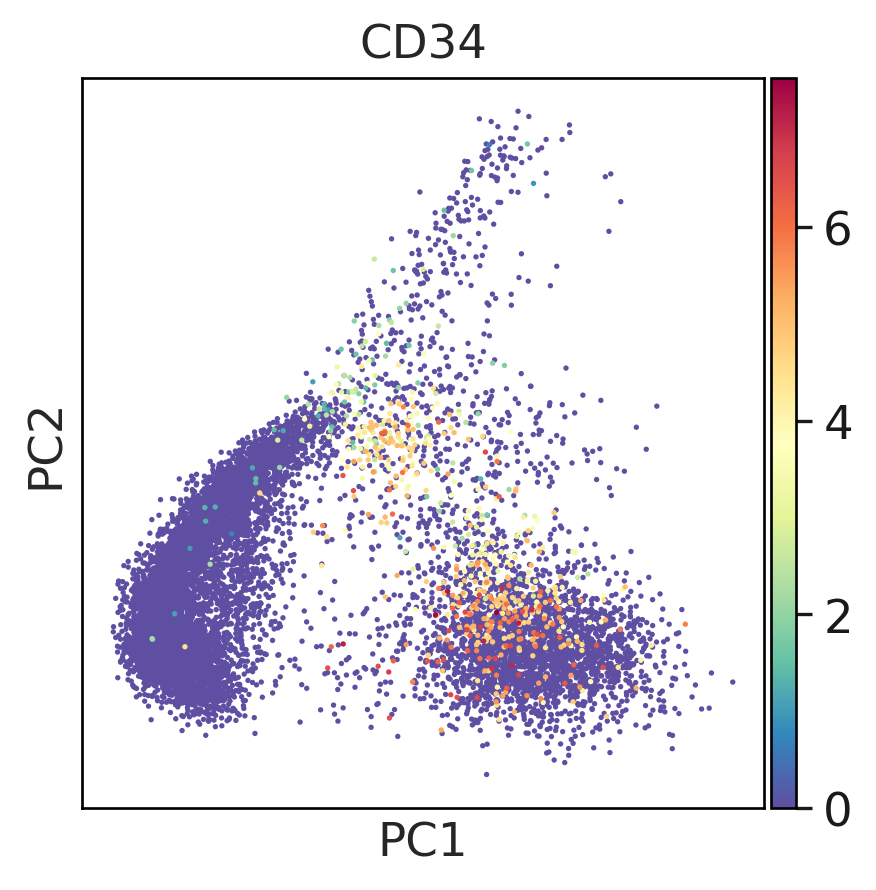

2024-01-24 20:30:00,896 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


Running Harmony


2024-01-24 20:30:46,532 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-01-24 20:30:46,817 - harmonypy - INFO - Iteration 1 of 10
2024-01-24 20:31:10,309 - harmonypy - INFO - Iteration 2 of 10
2024-01-24 20:31:35,114 - harmonypy - INFO - Iteration 3 of 10
2024-01-24 20:31:59,719 - harmonypy - INFO - Iteration 4 of 10
2024-01-24 20:32:22,602 - harmonypy - INFO - Iteration 5 of 10
2024-01-24 20:32:45,615 - harmonypy - INFO - Converged after 5 iterations
/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packag

Computing Diffusion maps...
Determing nearest neighbor graph...


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/umap/umap_.py:660: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


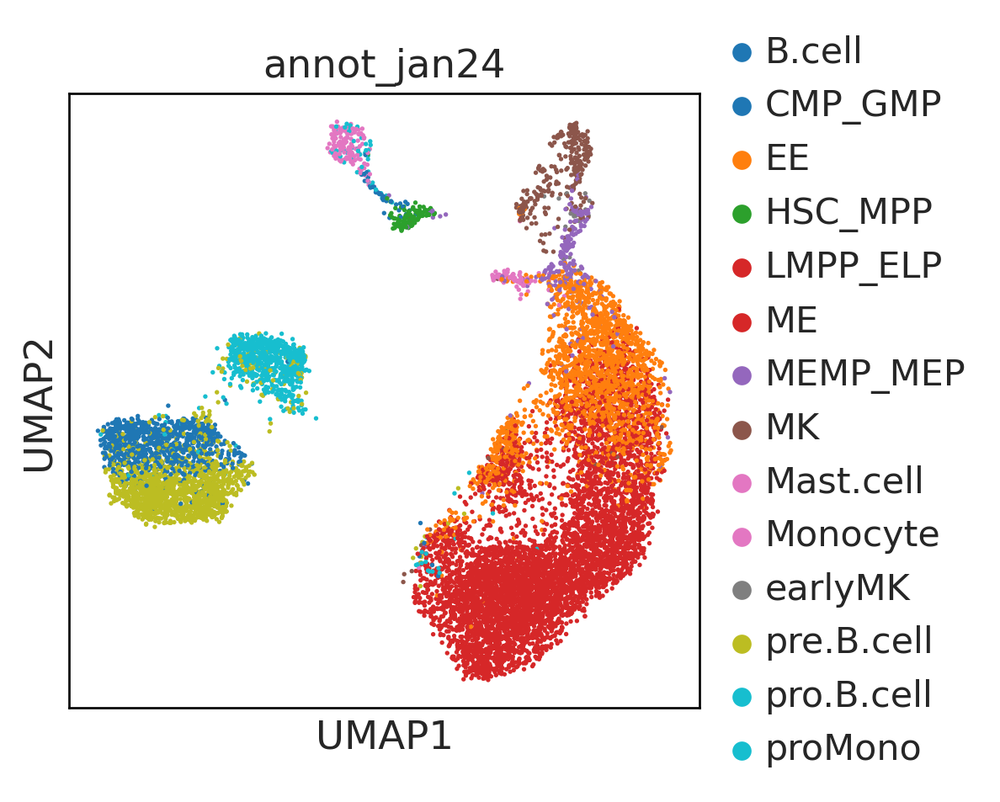

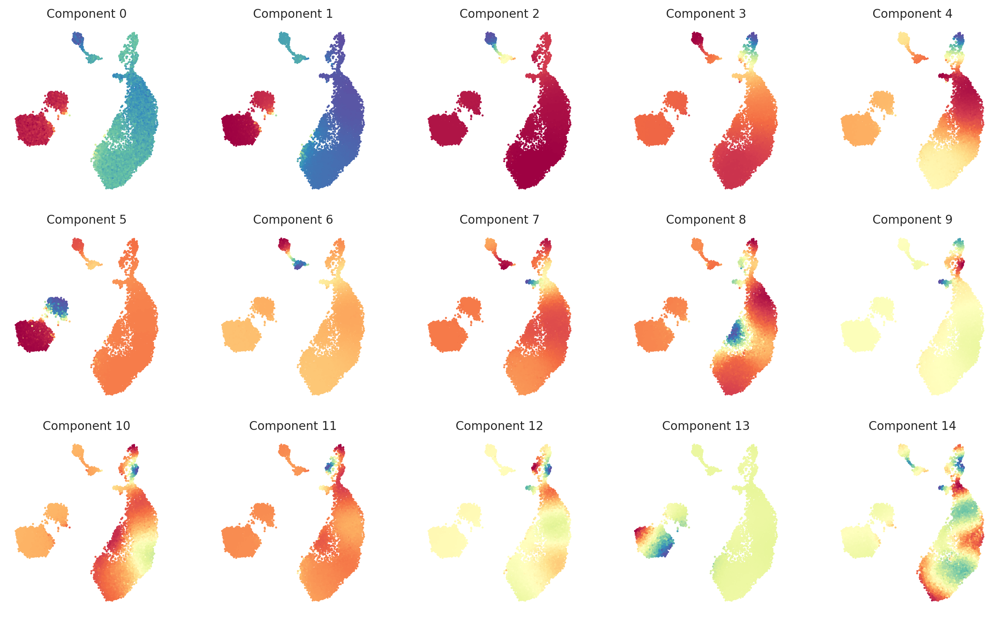

MAGIC imputation...


findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling bac

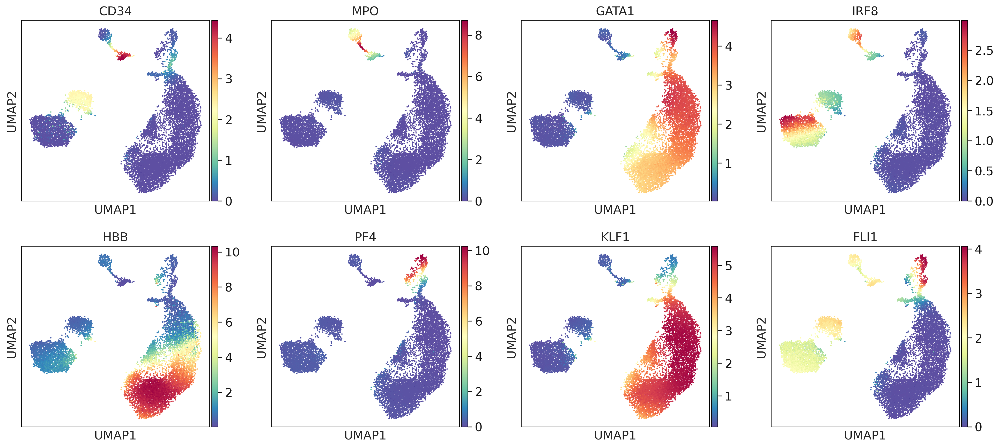

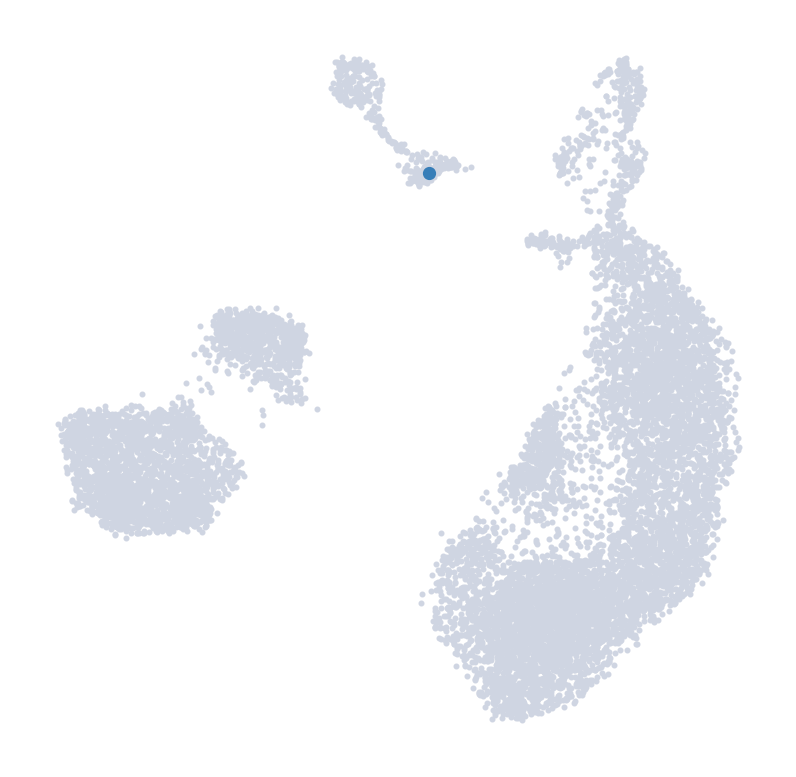

Using liv08_AACGAAACACTACTTT-1 for cell type Monocyte which is min in diffusion component 1.
Using liv67_TCAGCCTGTTCCTACC-1 for cell type ME which is max in diffusion component 1.
Using liv09_CGGGACTCAGCAAGAC-1 for cell type MK which is min in diffusion component 0.
Using liv09_TGCTCCACAGGCATGA-1 for cell type Mast.cell which is max in diffusion component 3.
Using liv08_TTACTGTGTACATACC-1 for cell type B.cell which is max in diffusion component 0.
Computing trajectory with Palantir...
Sampling and flocking waypoints...
Time for determining waypoints: 0.021570138136545815 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...


findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back t

Time for shortest paths: 0.22359947363535562 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9996
Correlation at iteration 2: 0.9999
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


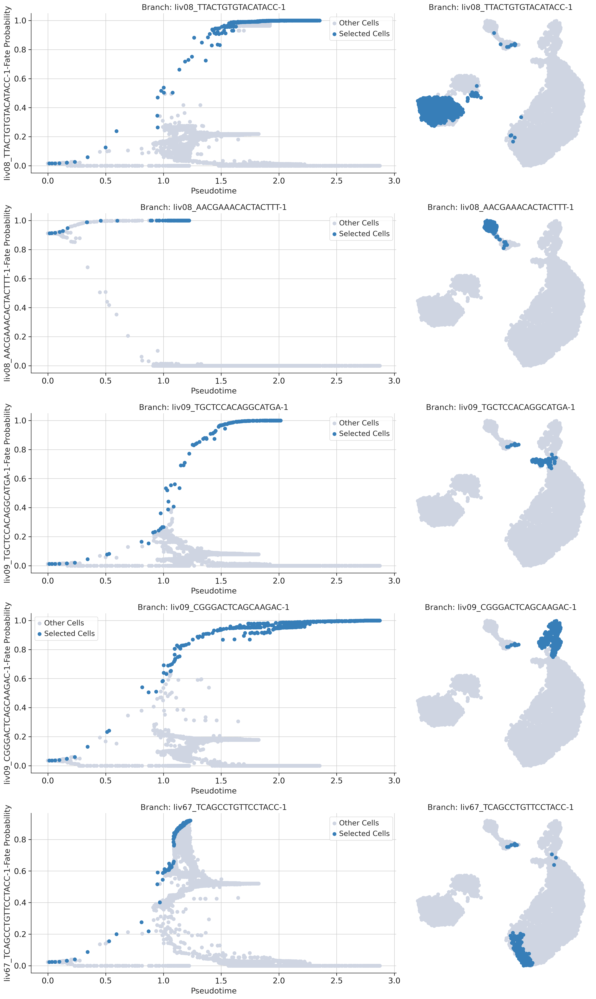

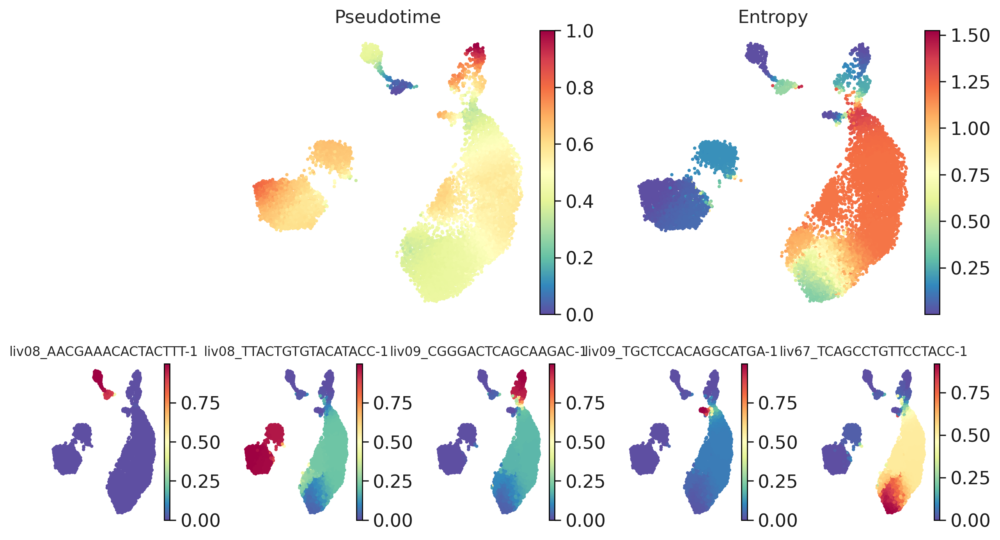

In [10]:
num_waypoints = 1200
runHarmony = True
harmonyVar = ['donorID','Phase']
terminal_states = None
annotation_key = 'annot_jan24'
use_early_cell_as_start=True
n_components=15

ad_T18 = adata_T18.copy()
#result_out_fp = '/home/jovyan/sc126/tmp_2312/1_palantir_output/T21_haemTraj.csv' # main output is a csv file
result_out_fp = '/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/T18_haemTraj.csv'
# define start cell
# eg. I defined start cells as HSC with highest expression of CD34
cd34_expr = ad_T18.X[ad_T18.obs['finalAnn_broad'] == 'HSC_MPP',np.where(ad_T18.var.index == 'CD34')[0].tolist()[0]].toarray()
# Find cell ID with highest expression level for CD34
start_cell = ad_T18.obs.loc[ad_T18.obs['finalAnn_broad'] == 'HSC_MPP',:].index[cd34_expr.argmax()]

## Define terminal states
terminal_celltypes = ['Monocyte','ME','MK','Mast.cell','B.cell']
determine_termState = True
palantir_results, ad_T18 = build_palantir_traj_v2(ad_T18,ann_key=annotation_key,start_cell=start_cell,
                                           result_out_fp=result_out_fp,num_waypoints=num_waypoints,n_components=n_components,
                                           runHarmony=runHarmony,harmonyVar=harmonyVar,
                                              terminal_states=terminal_states,
                                              determine_termState = determine_termState,
                                              terminal_celltypes=terminal_celltypes)


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


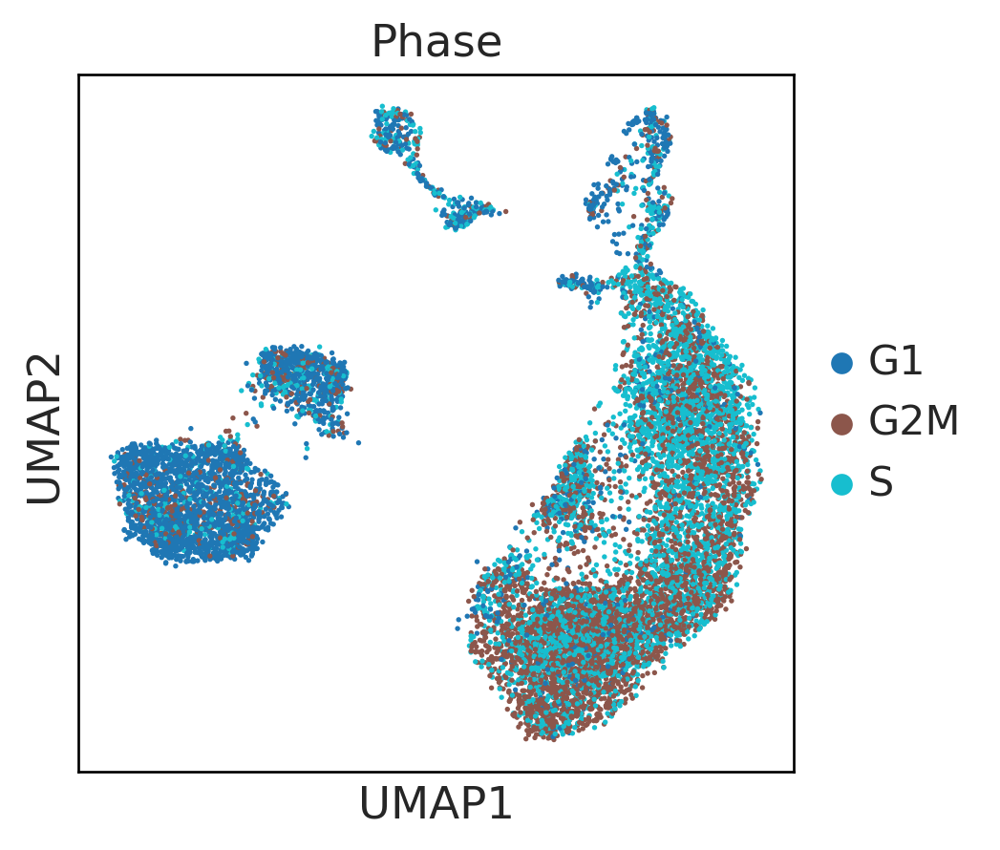

In [11]:
sc.pl.embedding(ad_T18, basis='umap',color=['Phase'],palette='tab10')

## Run Palantir on T22

In [44]:
celltypes_toKeep = ['HSC_MPP','MEMP_MEP','EE','ME',
                    #'Mast.cell',
                    'earlyMK','MK',
                   'LMPP_ELP','pro.B.cell','pre.B.cell','B.cell',
                    'CMP_GMP','proMono','MOP','Monocyte']#,'Macrophage']

In [45]:
adata_T22 = adata[(adata.obs['Genotype'] == 'T22') & 
                       (adata.obs['annot_jan24'].isin(celltypes_toKeep))
                      #(~adata_noCyc.obs['finalAnn_broad'].isin(['Hepatocyte','Endo','Kupffer.cell','Fibroblast','NPC','Mesenchyme']))
                      ]


Data processing...
Computing PCA...


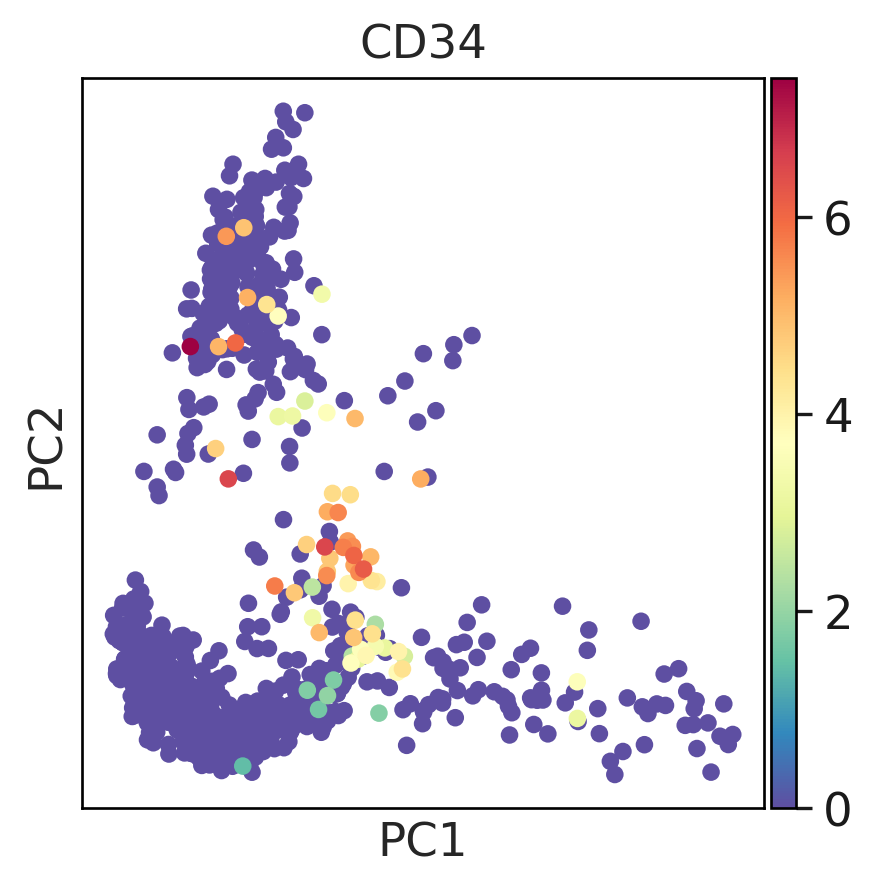

2024-01-24 22:23:24,253 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


Running Harmony


2024-01-24 22:23:28,121 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-01-24 22:23:28,204 - harmonypy - INFO - Iteration 1 of 10
2024-01-24 22:23:30,217 - harmonypy - INFO - Iteration 2 of 10
2024-01-24 22:23:31,605 - harmonypy - INFO - Iteration 3 of 10
2024-01-24 22:23:33,310 - harmonypy - INFO - Converged after 3 iterations


Computing Diffusion maps...
Determing nearest neighbor graph...


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


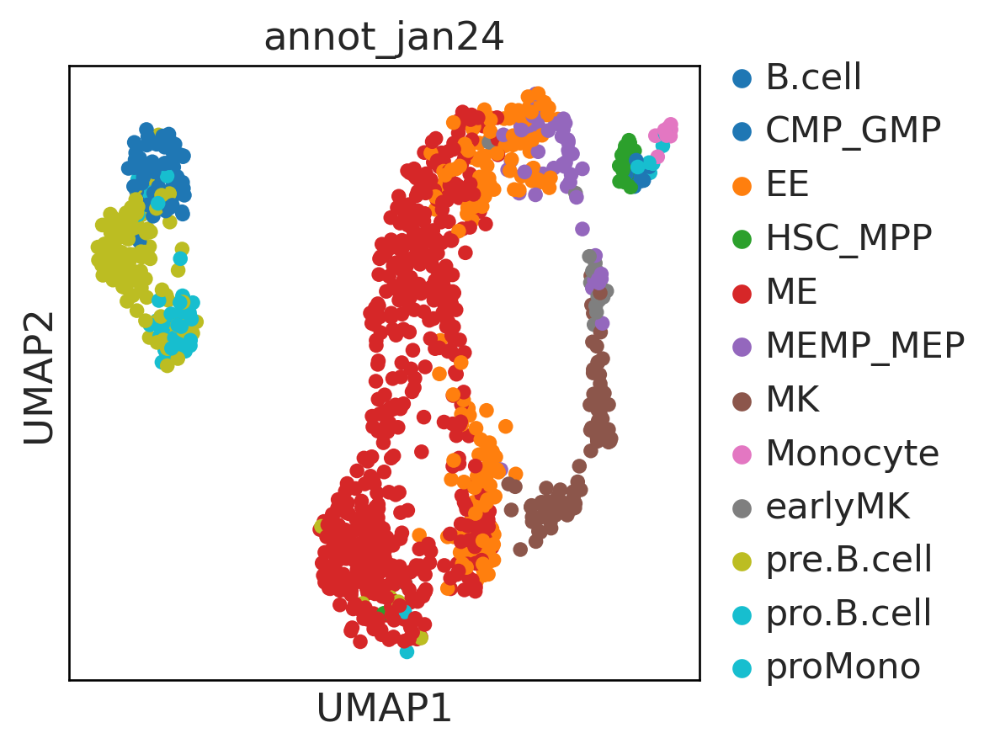

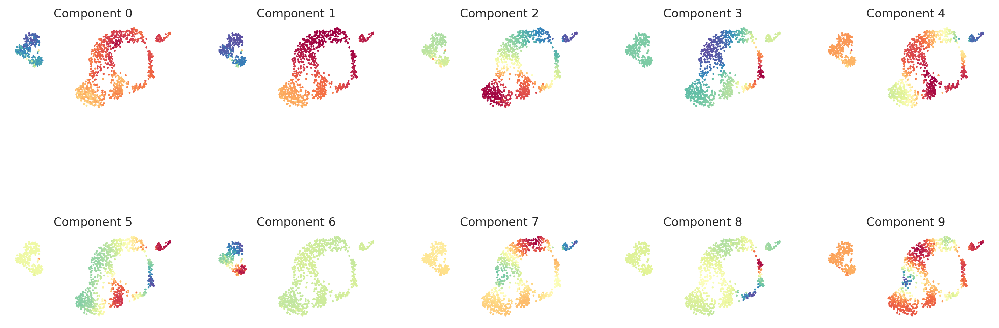

MAGIC imputation...


findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back t

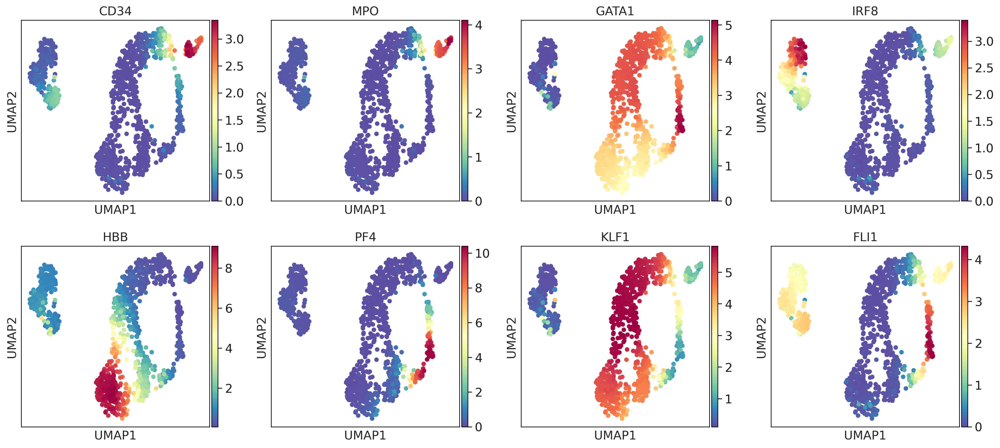

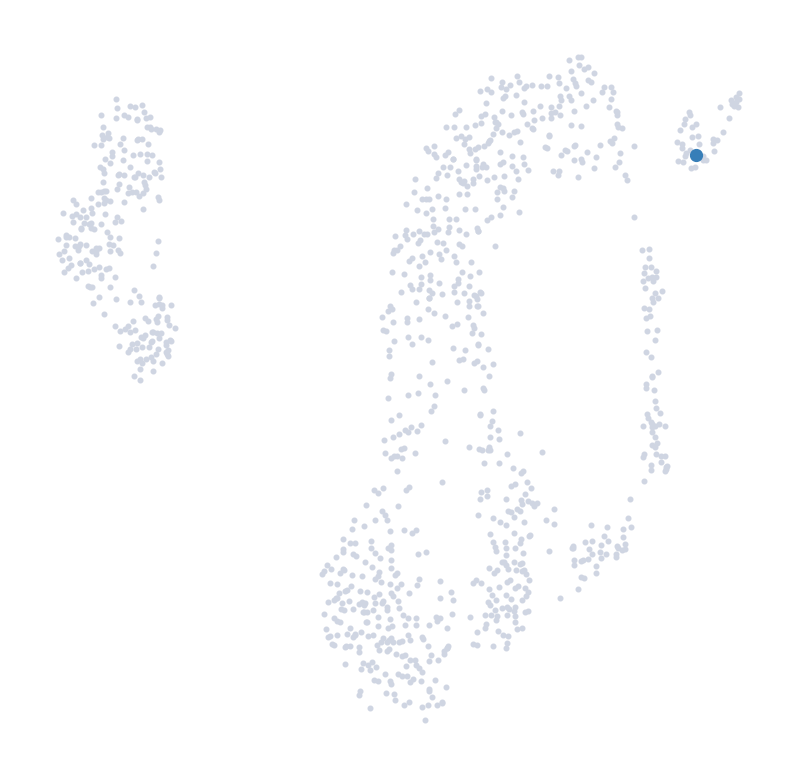

Computing trajectory with Palantir...
Sampling and flocking waypoints...
Time for determining waypoints: 0.0024349411328633626 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...


findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back t

Time for shortest paths: 0.07477298974990845 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


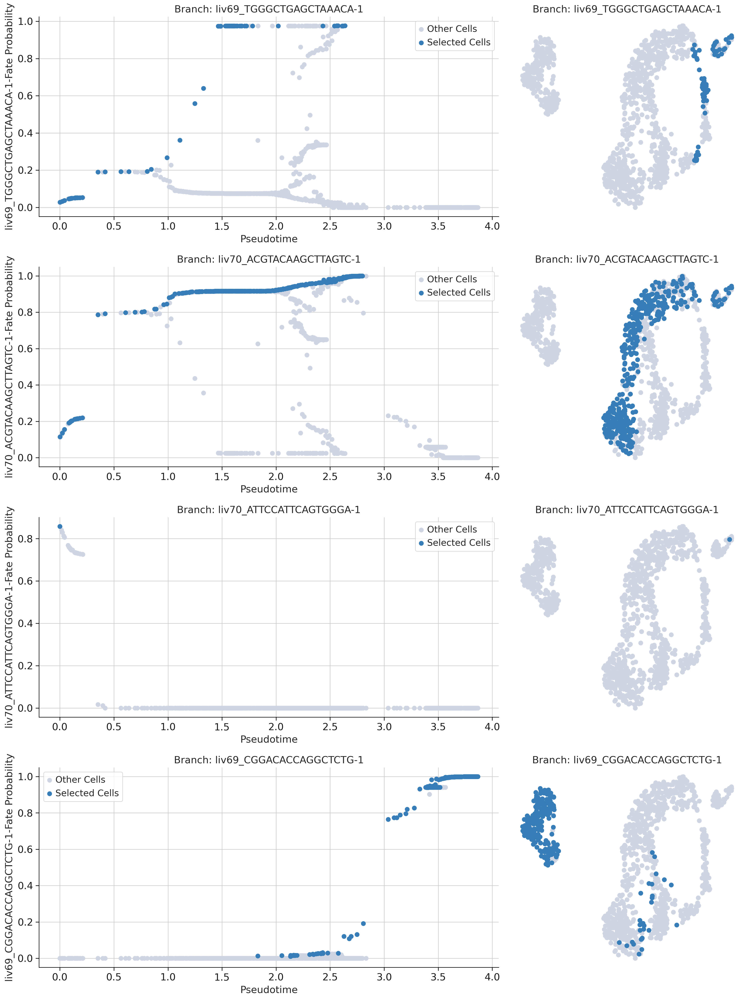

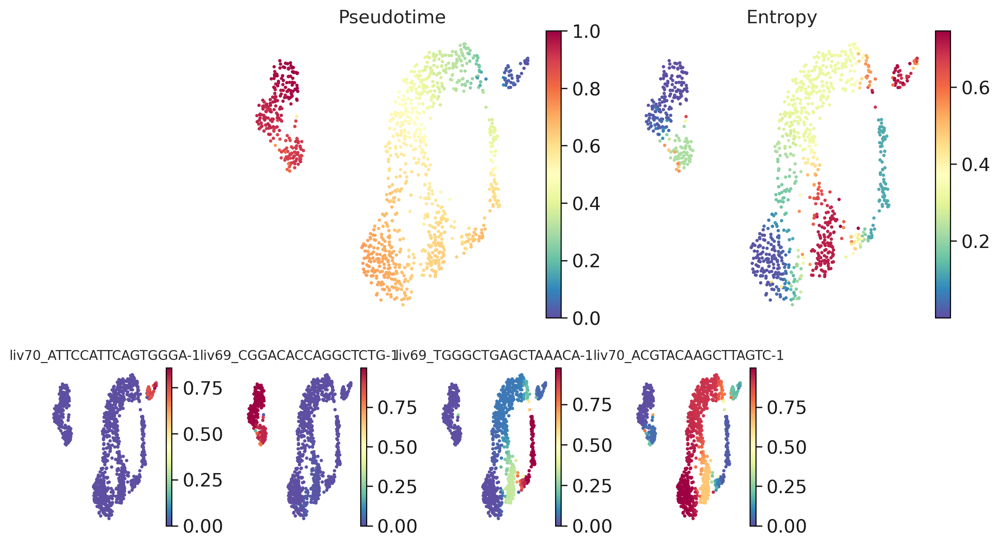

In [46]:
num_waypoints = 1200
runHarmony = True
harmonyVar = ['donorID','Phase']
terminal_states = None
annotation_key = 'annot_jan24'
use_early_cell_as_start=True
n_components=10

ad_T22 = adata_T22.copy()
#result_out_fp = '/home/jovyan/sc126/tmp_2312/1_palantir_output/T21_haemTraj.csv' # main output is a csv file
result_out_fp = '/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/T22_haemTraj.csv'
# define start cell
# eg. I defined start cells as HSC with highest expression of CD34
cd34_expr = ad_T22.X[ad_T22.obs['finalAnn_broad'] == 'HSC_MPP',np.where(ad_T22.var.index == 'CD34')[0].tolist()[0]].toarray()
# Find cell ID with highest expression level for CD34
start_cell = ad_T22.obs.loc[ad_T22.obs['finalAnn_broad'] == 'HSC_MPP',:].index[cd34_expr.argmax()]

## Define terminal states
terminal_celltypes = ['Monocyte','ME','MK','Mast.cell','B.cell']
determine_termState = False
terminal_states = ['liv70_ATTCCATTCAGTGGGA-1',#Mono
                                             'liv69_TGGGCTGAGCTAAACA-1',#MK
                                             'liv69_CGGACACCAGGCTCTG-1',#B
                                             'liv70_ACGTACAAGCTTAGTC-1'] # ME
palantir_results, ad_T22 = build_palantir_traj_v2(ad_T22,ann_key=annotation_key,start_cell=start_cell,
                                           result_out_fp=result_out_fp,num_waypoints=num_waypoints,n_components=n_components,
                                           runHarmony=runHarmony,harmonyVar=harmonyVar,
                                              terminal_states=terminal_states,
                                              determine_termState = determine_termState,
                                              terminal_celltypes=terminal_celltypes)


## Run Palantir on Triploid

In [47]:
celltypes_toKeep = ['HSC_MPP','MEMP_MEP','EE','ME',
                    'Mast.cell','earlyMK','MK',
                   'LMPP_ELP','pro.B.cell','pre.B.cell','B.cell',
                    'CMP_GMP','proMono','MOP','Monocyte']#,'Macrophage']

In [48]:
adata_Triploid = adata[(adata.obs['Genotype'] == 'complete_trisomy') & 
                       (adata.obs['annot_jan24'].isin(celltypes_toKeep))
                      #(~adata_noCyc.obs['finalAnn_broad'].isin(['Hepatocyte','Endo','Kupffer.cell','Fibroblast','NPC','Mesenchyme']))
                      ]


Data processing...
Computing PCA...


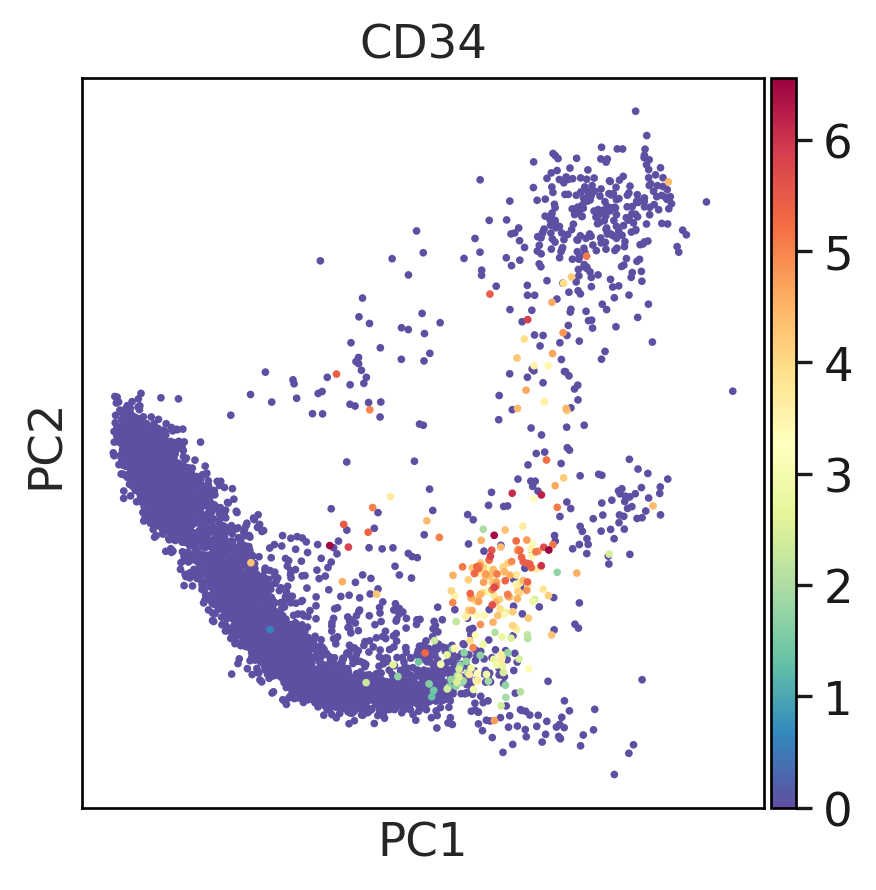

2024-01-24 22:25:57,842 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


Running Harmony


2024-01-24 22:26:28,205 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-01-24 22:26:28,417 - harmonypy - INFO - Iteration 1 of 10
2024-01-24 22:26:35,017 - harmonypy - INFO - Iteration 2 of 10
2024-01-24 22:26:41,419 - harmonypy - INFO - Iteration 3 of 10
2024-01-24 22:26:47,709 - harmonypy - INFO - Converged after 3 iterations


Computing Diffusion maps...
Determing nearest neighbor graph...


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


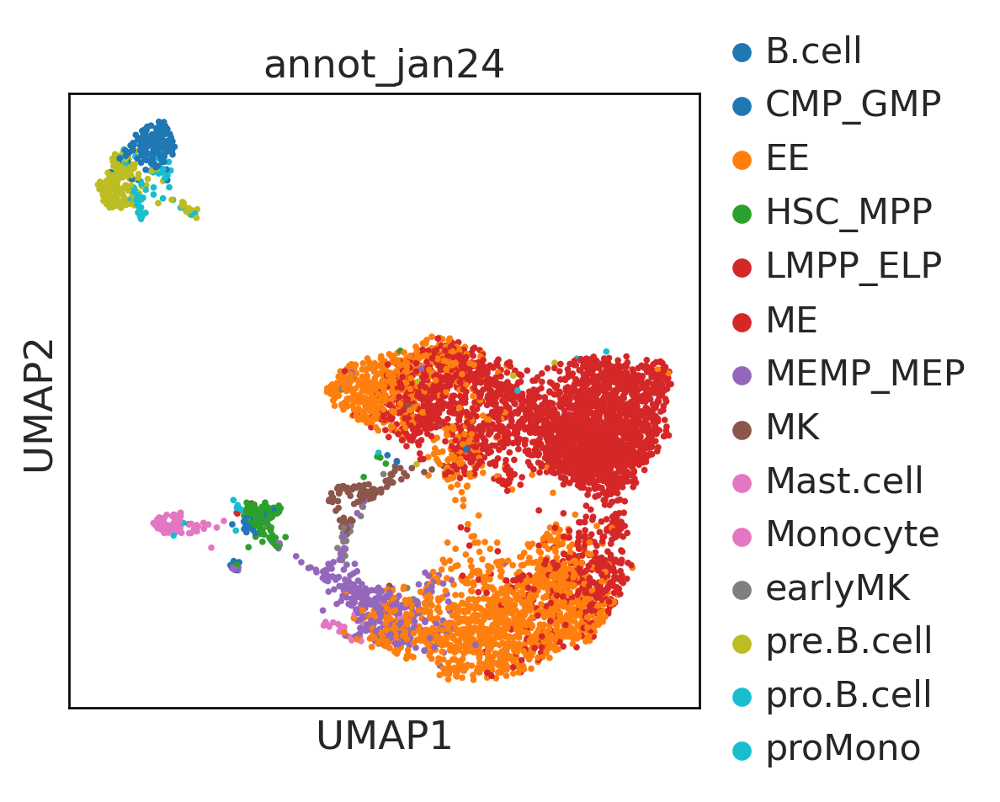

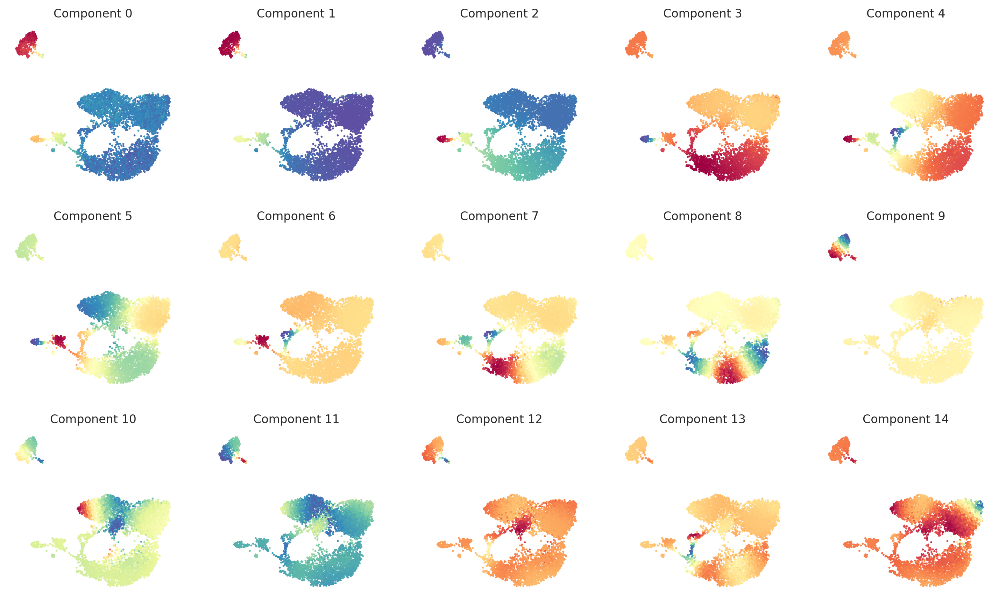

MAGIC imputation...


findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back t

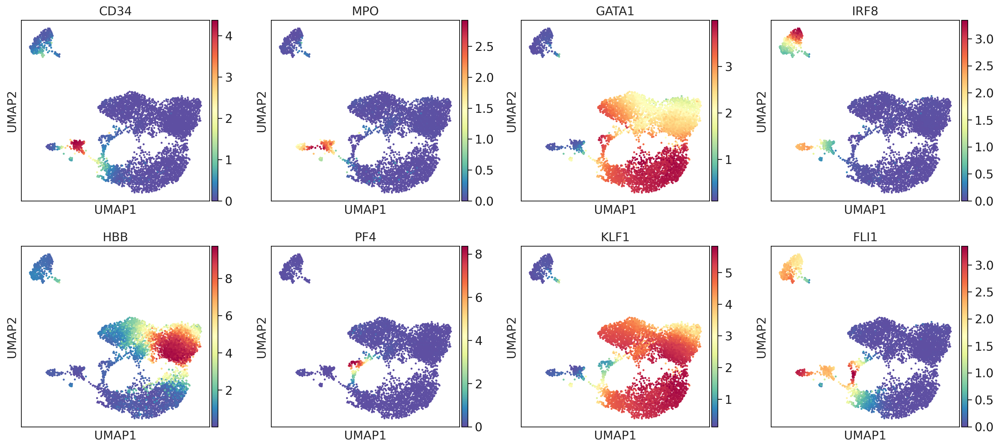

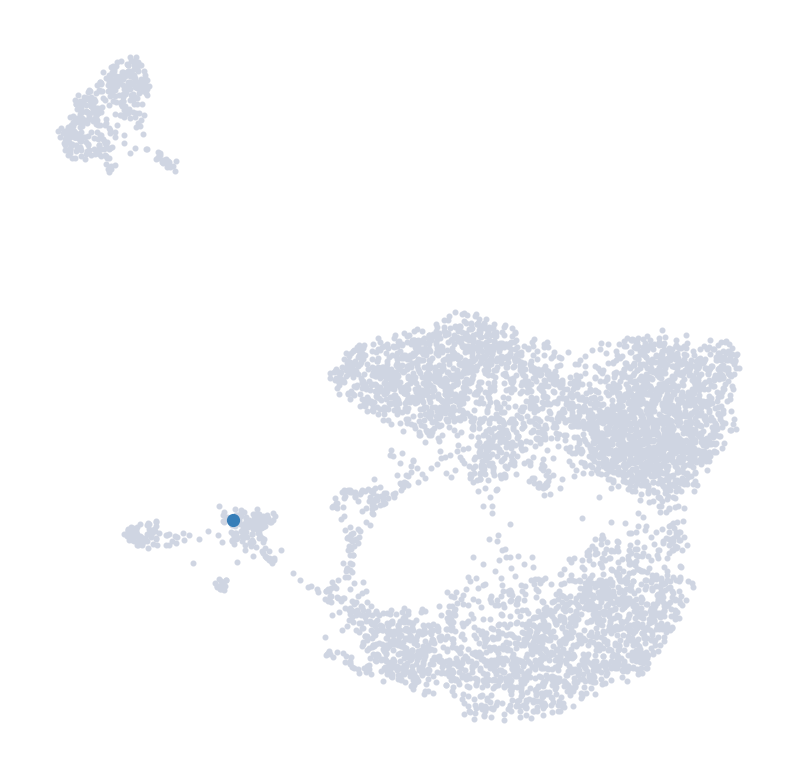

Using liv99_ATCGTCCCAGCAGTTT-1 for cell type Monocyte which is max in diffusion component 1.
Using liv99_TGAGCGCTCAGCGTCG-1 for cell type ME which is min in diffusion component 0.
Using liv98_CATCGTCCATGACTCA-1 for cell type MK which is min in diffusion component 3.


CellNotFoundException: No valid component found: Mast.cell Consider increasing the number of diffusion components ('n_components' in palantir.utils.run_diffusion_maps) or specify a 'fallback_seed' to determine an early cell based on reverse pseudotime starting from random non-Mast.cell cell.

In [49]:
num_waypoints = 1200
runHarmony = True
harmonyVar = ['donorID','Phase']
terminal_states = None
annotation_key = 'annot_jan24'
use_early_cell_as_start=True
n_components=15

ad_Triploid = adata_Triploid.copy()
#result_out_fp = '/home/jovyan/sc126/tmp_2312/1_palantir_output/T21_haemTraj.csv' # main output is a csv file
result_out_fp = '/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/Triploid_haemTraj.csv'
# define start cell
# eg. I defined start cells as HSC with highest expression of CD34
cd34_expr = ad_Triploid.X[ad_Triploid.obs['finalAnn_broad'] == 'HSC_MPP',np.where(ad_Triploid.var.index == 'CD34')[0].tolist()[0]].toarray()
# Find cell ID with highest expression level for CD34
start_cell = ad_Triploid.obs.loc[ad_Triploid.obs['finalAnn_broad'] == 'HSC_MPP',:].index[cd34_expr.argmax()]

## Define terminal states
terminal_celltypes = ['Monocyte','ME','MK','Mast.cell','B.cell']
determine_termState = True
palantir_results, ad_Triploid = build_palantir_traj_v2(ad_Triploid,ann_key=annotation_key,start_cell=start_cell,
                                           result_out_fp=result_out_fp,num_waypoints=num_waypoints,n_components=n_components,
                                           runHarmony=runHarmony,harmonyVar=harmonyVar,
                                              terminal_states=terminal_states,
                                              determine_termState = determine_termState,
                                              terminal_celltypes=terminal_celltypes)


## Run Palantir on MX

In [47]:
celltypes_toKeep = ['HSC_MPP','MEMP_MEP','EE','ME',
                    'Mast.cell','earlyMK','MK',
                   'LMPP_ELP','pro.B.cell','pre.B.cell','B.cell',
                    'CMP_GMP','proMono','MOP','Monocyte']#,'Macrophage']

In [48]:
adata_MX = adata[(adata.obs['Genotype'] == 'MX') & 
                       (adata.obs['annot_jan24'].isin(celltypes_toKeep))
                      #(~adata_noCyc.obs['finalAnn_broad'].isin(['Hepatocyte','Endo','Kupffer.cell','Fibroblast','NPC','Mesenchyme']))
                      ]


Data processing...
Computing PCA...


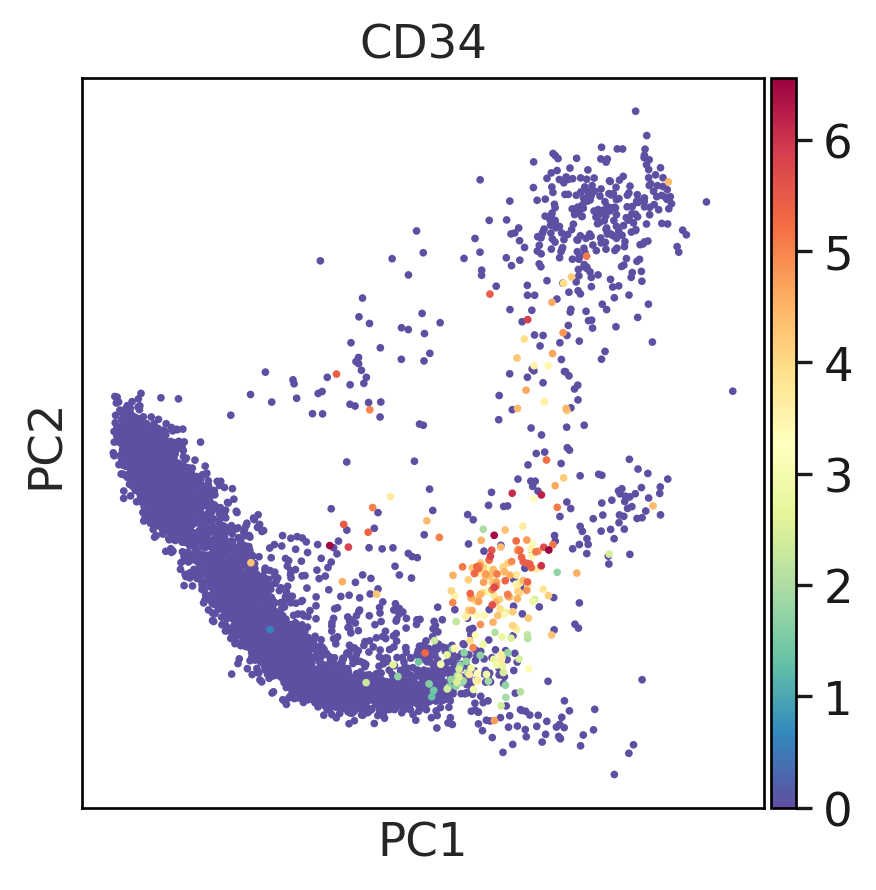

2024-01-24 22:25:57,842 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


Running Harmony


In [ ]:
num_waypoints = 1200
runHarmony = True
harmonyVar = ['donorID','Phase']
terminal_states = None
annotation_key = 'annot_jan24'
use_early_cell_as_start=True
n_components=15

ad_MX = adata_MX.copy()
#result_out_fp = '/home/jovyan/sc126/tmp_2312/1_palantir_output/T21_haemTraj.csv' # main output is a csv file
result_out_fp = '/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/Triploid_haemTraj.csv'
# define start cell
# eg. I defined start cells as HSC with highest expression of CD34
cd34_expr = ad_MX.X[ad_MX.obs['finalAnn_broad'] == 'HSC_MPP',np.where(ad_MX.var.index == 'CD34')[0].tolist()[0]].toarray()
# Find cell ID with highest expression level for CD34
start_cell = ad_MX.obs.loc[ad_MX.obs['finalAnn_broad'] == 'HSC_MPP',:].index[cd34_expr.argmax()]

## Define terminal states
terminal_celltypes = ['Monocyte','ME','MK','Mast.cell','B.cell']
determine_termState = True
palantir_results, ad_MX = build_palantir_traj_v2(ad_MX,ann_key=annotation_key,start_cell=start_cell,
                                           result_out_fp=result_out_fp,num_waypoints=num_waypoints,n_components=n_components,
                                           runHarmony=runHarmony,harmonyVar=harmonyVar,
                                              terminal_states=terminal_states,
                                              determine_termState = determine_termState,
                                              terminal_celltypes=terminal_celltypes)


## Run Palantir on all Genotypes

In [28]:
celltypes_toKeep = ['HSC_MPP','MEMP_MEP','EE','ME','LE',
                    'Mast.cell','earlyMK','MK',
                   'LMPP_ELP','pro.B.cell','pre.B.cell','B.cell',
                    'CMP_GMP','proMono','MOP','Monocyte']#,'Macrophage']


In [30]:
adata_all = adata[#(adata.obs['published_ann_2'] == 'NA') & 
                 (adata.obs['finalAnn_broad'].isin(celltypes_toKeep)) &
                 (adata.obs['cellID_toKeep']==True)
                 ]
print(adata_all.obs.Genotype.value_counts())

T21                 44948
diploid             44329
T18                 16569
MX                  13008
complete_trisomy     6825
T22                  2182
Name: Genotype, dtype: int64


In [29]:
# mdat = pd.read_csv('/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/liver_liverREFmerged_clean_processed_annotated_noUnknowns_0124_mdat_forPalantir.csv')
# cellID_toKeep = mdat.cellID[mdat.cellID_toKeep == True]
# adata_all = adata[(adata.obs['cellID'].isin(cellID_toKeep))]

Data processing...
Computing PCA...


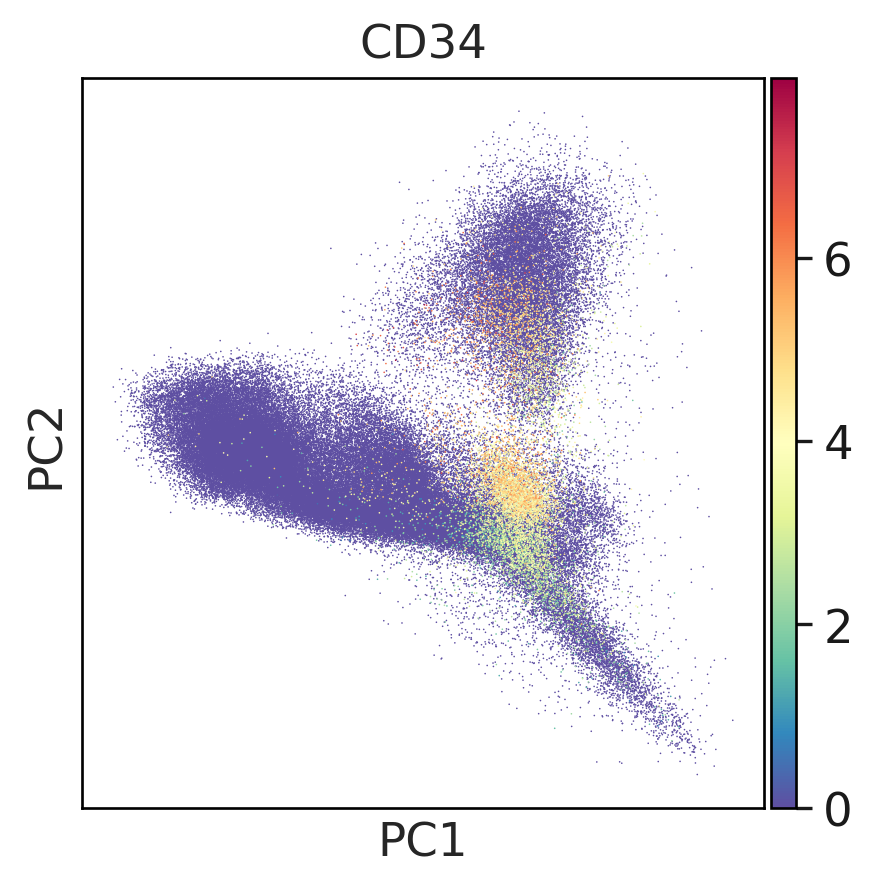

Computing Diffusion maps...
Determing nearest neighbor graph...


/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


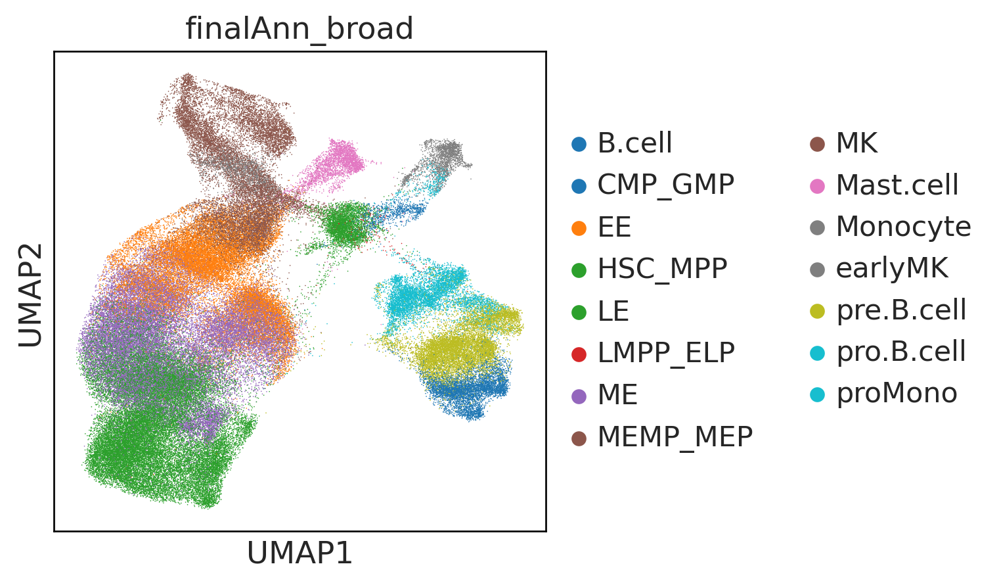

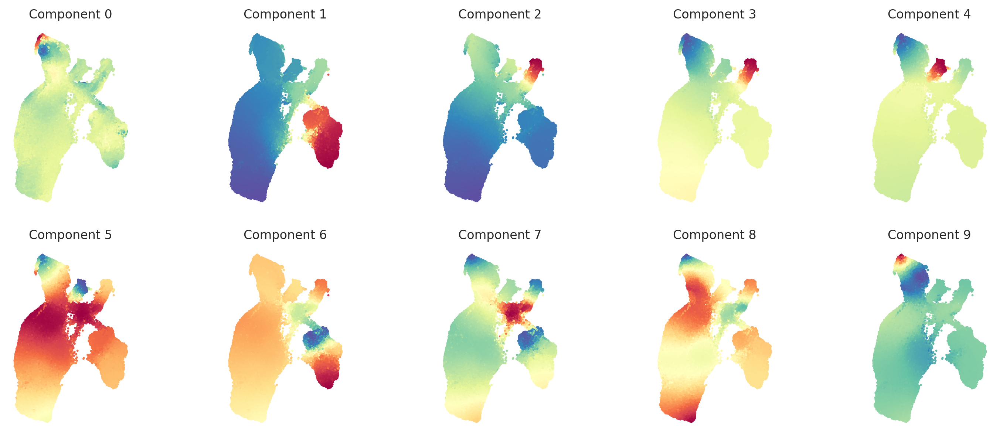

MAGIC imputation...


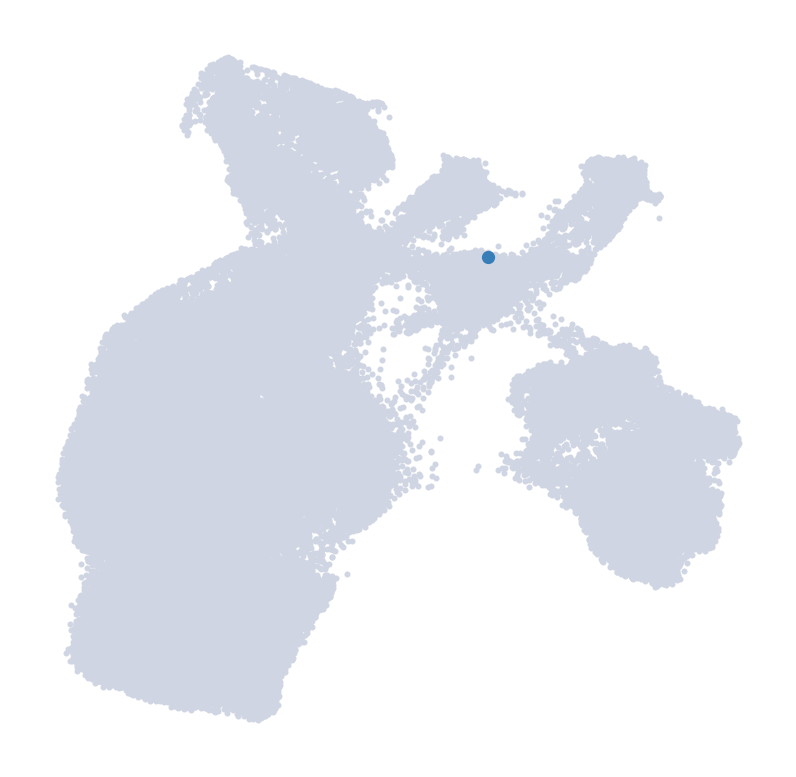

Using liv68_GTCCCATGTGCATTTG-1 for cell type Monocyte which is max in diffusion component 1.
Using liv69_CCGTGAGGTCCACATA-1 for cell type LE which is min in diffusion component 0.
Using liv16_TTACGTTCATTATGCG-1 for cell type MK which is min in diffusion component 2.
Using MY.200531.14665737_AGGGTTTGTAAGGCTG-1 for cell type Mast.cell which is max in diffusion component 3.
Using liv08_CATGCTCTCTTCCCAG-1 for cell type B.cell which is max in diffusion component 0.
Computing trajectory with Palantir...
Sampling and flocking waypoints...
Time for determining waypoints: 0.8838275750478108 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...


findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falli

Time for shortest paths: 5.885018360614777 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9996
Correlation at iteration 2: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


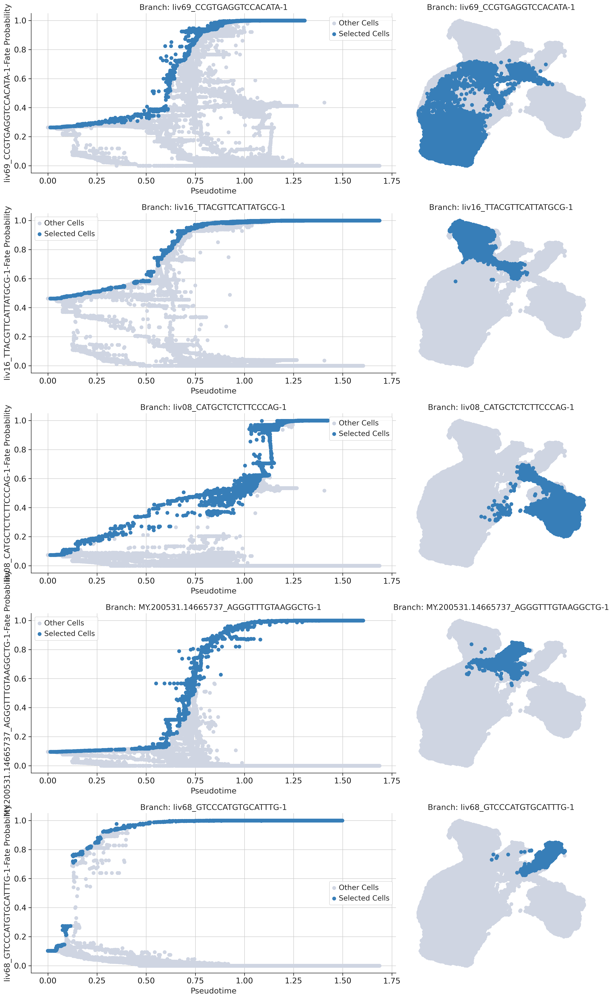

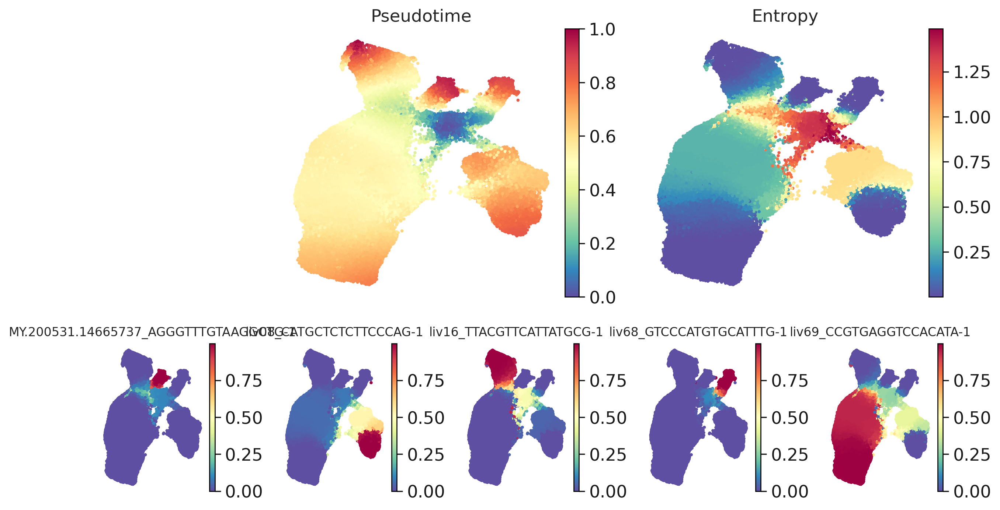

In [31]:
num_waypoints = 1500
runHarmony = False
harmonyVar = ['donorID','Phase']
terminal_states = None
annotation_key = 'finalAnn_broad'
use_early_cell_as_start=True
n_components=10

ad_all = adata_all.copy()
#result_out_fp = '/home/jovyan/sc126/tmp_2312/1_palantir_output/T21_haemTraj.csv' # main output is a csv file
result_out_fp = '/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/allGeno_haemTraj_noPublished2n_apr24.csv'
# define start cell
# eg. I defined start cells as HSC with highest expression of CD34
cd34_expr = ad_all.X[ad_all.obs['finalAnn_broad'] == 'HSC_MPP',np.where(ad_all.var.index == 'CD34')[0].tolist()[0]].toarray()
# Find cell ID with highest expression level for CD34
start_cell = ad_all.obs.loc[ad_all.obs['finalAnn_broad'] == 'HSC_MPP',:].index[cd34_expr.argmax()]

## Define terminal states
#terminal_celltypes = ['Monocyte','EE','MK','Mast.cell','B.cell']
terminal_celltypes = ['Monocyte','LE','MK','Mast.cell','B.cell']
determine_termState = True
palantir_results, ad_all = build_palantir_traj_v2(ad_all,ann_key=annotation_key,start_cell=start_cell,
                                           result_out_fp=result_out_fp,num_waypoints=num_waypoints,n_components=n_components,
                                           runHarmony=runHarmony,harmonyVar=harmonyVar,
                                              terminal_states=terminal_states,
                                              determine_termState = determine_termState,
                                              terminal_celltypes=terminal_celltypes)


In [33]:
ad_all.write_h5ad('/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/fLiver_allGeno_MKlin_forCellRank_apr24.h5ad',compression='gzip')
#ad_2n_mk.obs.to_csv('/home/jovyan/lustre_mt22/Aneuploidy/Results/9c_fLiver_trajectory/1_palantir_output/fLiver_inhouse2n_MKlin_forG2G_mdat.csv')

/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/palantir/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


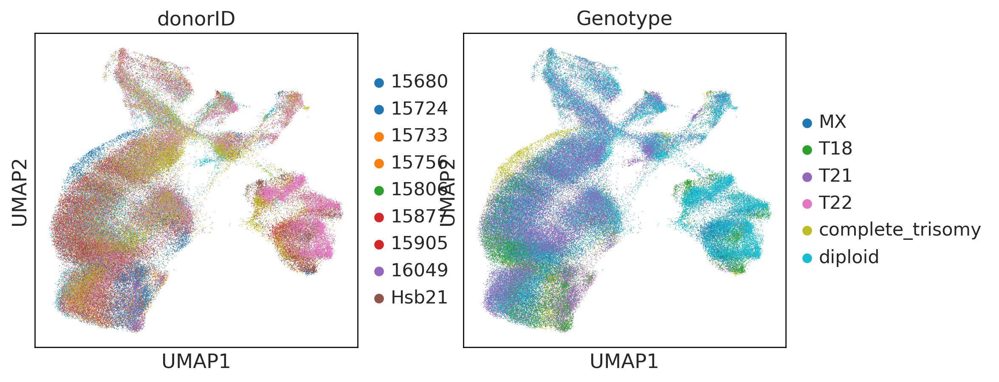

In [32]:
sc.pl.embedding(ad_all, basis='umap',color=['donorID','Genotype'],palette='tab10')